<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">

# Part 2: Preprocessing, Modelling and Evaluation


In [ ]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

import os, json
from glob import glob
import numpy as np

import keras

from tensorflow.keras import optimizers

from tensorflow.keras.applications import InceptionV3, ResNet50,InceptionResNetV2
from tensorflow.keras.applications.vgg16 import VGG16


from tensorflow.python.keras.preprocessing import image
from tensorflow.python.keras.preprocessing.image import ImageDataGenerator, load_img
from tensorflow.keras.utils import to_categorical, plot_model


from tensorflow.python.keras.models import Model,load_model,Sequential

from tensorflow.python.keras.layers import Dense, GlobalAveragePooling2D, Dropout,Flatten, Input, Conv2D, MaxPooling2D, Dropout, Flatten, GlobalAveragePooling2D, Activation, BatchNormalization
from tensorflow.python.keras import backend as K

from tensorflow.keras.callbacks import ModelCheckpoint, Callback, EarlyStopping

from sklearn.model_selection import train_test_split
from sklearn.metrics import plot_confusion_matrix,confusion_matrix,classification_report

import glob
import pandas as pd



## Data Preparation

In [ ]:
# Unzipping Image Datasets into Colab's VM Storage
!unzip /content/drive/MyDrive/GA/Capstone/datasets/datasets_v2.zip 

Streaming output truncated to the last 5000 lines.
  inflating: datasets/validation/grilled_salmon/Aug1134.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1139.jpg  
  inflating: datasets/validation/grilled_salmon/Aug115.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1154.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1157.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1174.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1193.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1203.jpg  
  inflating: datasets/validation/grilled_salmon/Aug122.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1238.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1245.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1251.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1253.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1265.jpg  
  inflating: datasets/validation/grilled_salmon/Aug1267.jpg  
  inflating: datasets

### Extracting the food names from the folder names

In [ ]:
food_folders = glob.glob('datasets/train/*')
food_labels = [food.split('/')[2] for food in food_folders]
food_labels = sorted(food_labels)
food_labels

['bibimbap',
 'caesar_salad',
 'carrot_cake',
 'chicken_curry',
 'club_sandwich',
 'edamame',
 'fish_and_chips',
 'french_fries',
 'french_toast',
 'fresh_spring_roll',
 'fried_calamari',
 'fried_rice',
 'grilled_salmon',
 'gyoza',
 'hot_and_sour_soup',
 'hummus',
 'miso_soup',
 'omelette',
 'pad_thai',
 'peking_duck',
 'pho',
 'ramen',
 'samosa',
 'sashimi',
 'seaweed_salad',
 'spring_rolls',
 'steamed_mussels',
 'sushi',
 'xiao long bao']

In [ ]:
train_path = 'datasets/train'
validation_path = 'datasets/validation'
test_path = 'datasets/test'

In [ ]:
# Function to plot images 
def plotImages(images_arr):
  fig, axes = plt.subplots(2,5,figsize=(16,9))
  axes = axes.flatten()
  for imag, ax in zip(images_arr,axes):
    ax.imshow(imag.astype('uint8'))
    ax.axis('off')
  plt.tight_layout()
  plt.show()

In [ ]:
def plotImages_with_labels(images_arr,label):
    fig, axes = plt.subplots(3,5,figsize=(16,9))
    axes = axes.flatten()
    for imag,lb, ax in zip(images_arr,label,axes):
        food_name = food_labels[np.argmax(lb)]
        ax.imshow(imag.astype('uint8'))
        ax.set_title(food_name)
        ax.axis('off')
    plt.tight_layout()
    #plt.show()

### Reading the image from directory

- **Training** : 76345 images (29 classes)
- **Validation** : 8699 images (29 classes)
- **Testing** : 580 images (29 classes)

In [ ]:
train_batches = ImageDataGenerator().flow_from_directory(directory=train_path,target_size=(256,256),classes=food_labels,batch_size=100,seed=1)
validation_batches = ImageDataGenerator().flow_from_directory(directory=validation_path,target_size=(256,256),classes=food_labels,batch_size=100)
test_batches = ImageDataGenerator().flow_from_directory(directory=test_path,target_size=(256,256),classes=food_labels,batch_size=100,shuffle=False)

Found 76345 images belonging to 29 classes.
Found 8699 images belonging to 29 classes.
Found 580 images belonging to 29 classes.


In [ ]:
# Making a dictionary for the labels
food_label_dict = dict((y,x) for x,y in train_batches.class_indices.items())
food_label_dict

{0: 'bibimbap',
 1: 'caesar_salad',
 2: 'carrot_cake',
 3: 'chicken_curry',
 4: 'club_sandwich',
 5: 'edamame',
 6: 'fish_and_chips',
 7: 'french_fries',
 8: 'french_toast',
 9: 'fresh_spring_roll',
 10: 'fried_calamari',
 11: 'fried_rice',
 12: 'grilled_salmon',
 13: 'gyoza',
 14: 'hot_and_sour_soup',
 15: 'hummus',
 16: 'miso_soup',
 17: 'omelette',
 18: 'pad_thai',
 19: 'peking_duck',
 20: 'pho',
 21: 'ramen',
 22: 'samosa',
 23: 'sashimi',
 24: 'seaweed_salad',
 25: 'spring_rolls',
 26: 'steamed_mussels',
 27: 'sushi',
 28: 'xiao long bao'}

### Images before preprocessing

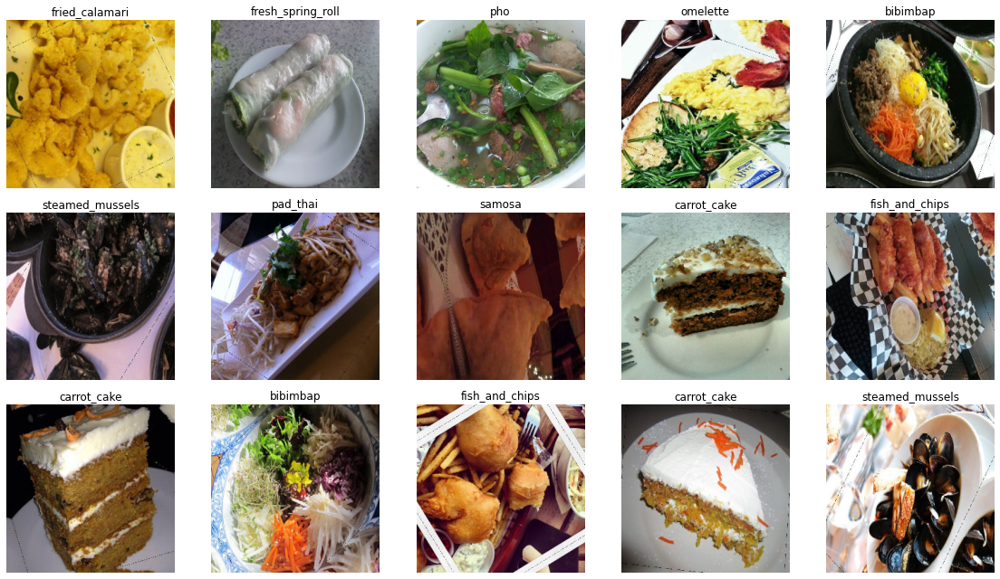

In [ ]:
imgs, labels = next(train_batches)
plotImages_with_labels(imgs[:15],labels[:15])

## Preprocessing

The project includes two preprocessing techiniques that were used to normalize the image data.

- **Inception V3 Preprocessing**: The pixel values are processed so that they are between -1 and 1.

- **VGG16 Preprocessing**: The values in each colour channel of an image is subtracted by the mean values for each colour channel of the ImageNet datasets. (Zero centered wrt ImageNet)

The preprocessing techniques will be explicitly specified for each model. 

### Examples of Preprocessed Images

#### Inception V3 Preprocessing

In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input).flow_from_directory(directory=train_path,target_size=(256,256),classes=food_labels,batch_size=100,seed=1)

Found 76345 images belonging to 29 classes.


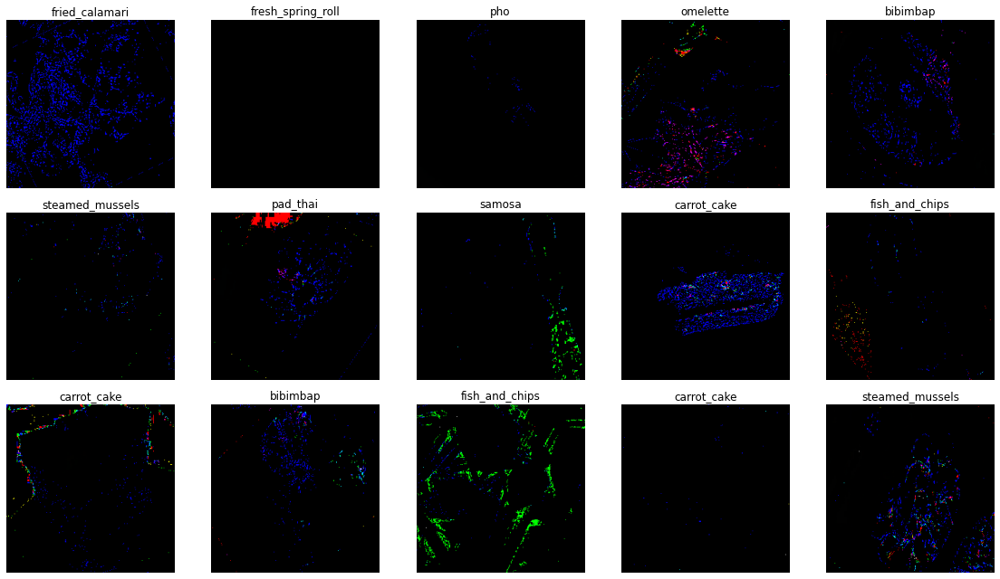

In [ ]:
imgs, labels = next(train_batches)
plotImages_with_labels(imgs[:15],labels[:15])

#### VGG16 Preprocessing

In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=train_path,target_size=(256,256),classes=food_labels,batch_size=100,seed=1)

Found 76345 images belonging to 29 classes.


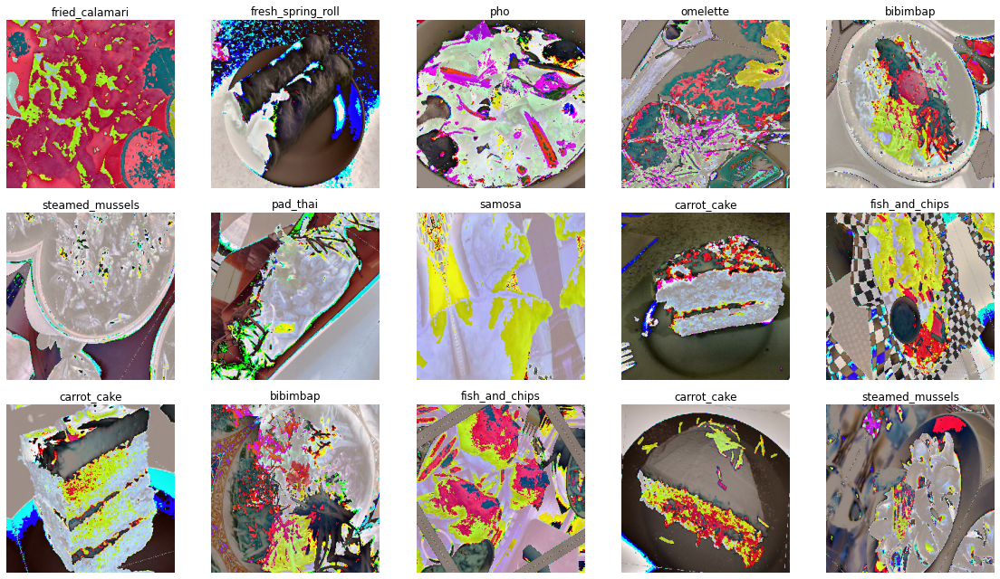

In [ ]:
imgs, labels = next(train_batches)
plotImages_with_labels(imgs[:15],labels[:15])

## Modelling




### Custom Model

#### Description

This first model is built sequentially from scratch. It uses ***Inception V3 preprocessing*** technique that normalizes the value between -1 and 1. The basic architecture blocks include multiple two convolutional layers with identical number of filters with 3x3 kernels using the relu activation function. This is then normalized using batch normalization. Overall the model has 15 layers and approximately 5m trainable parameters.

In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input).flow_from_directory(directory=train_path,target_size=(256,256),classes=food_labels,batch_size=100)
validation_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input).flow_from_directory(directory=validation_path,target_size=(256,256),classes=food_labels,batch_size=100)
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input).flow_from_directory(directory=test_path,target_size=(256,256),classes=food_labels,batch_size=100,shuffle=False)

Found 76345 images belonging to 29 classes.
Found 8699 images belonging to 29 classes.
Found 580 images belonging to 29 classes.


In [ ]:
# Function to create the custom model
def create_custom():
  model = Sequential()
  model.add(Conv2D(filters=64, kernel_size=(3,3),padding='same',input_shape=(256,256,3)))
  model.add(Activation(activation='relu'))
  model.add(Conv2D(filters=64,kernel_size=(3,3),padding='same'))
  model.add(Activation(activation='relu'))
  model.add(BatchNormalization())
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Conv2D(filters=128,kernel_size=(3,3),padding='same'))
  model.add(Activation(activation='relu'))
  model.add(Conv2D(filters=128,kernel_size=(3,3),padding='same'))
  model.add(Activation(activation='relu'))
  model.add(BatchNormalization())
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Conv2D(filters=256,kernel_size=(3,3),padding='same'))
  model.add(Activation(activation='relu'))
  model.add(Conv2D(filters=256,kernel_size=(3,3),padding='same'))
  model.add(Activation(activation='relu'))
  model.add(BatchNormalization())
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Conv2D(filters=512,kernel_size=(3,3),padding='same'))
  model.add(Activation(activation='relu'))
  model.add(Conv2D(filters=512,kernel_size=(3,3),padding='same'))
  model.add(Activation(activation='relu'))
  model.add(BatchNormalization())
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(GlobalAveragePooling2D())
  model.add(Dense(512,activation='relu'))
  model.add(Dropout(0.3))
  model.add(Dense(29,activation='softmax'))
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00001),loss='categorical_crossentropy',metrics=['accuracy'])
  return model

In [ ]:
# Creating the custom model
model = create_custom()

#### Model diagram

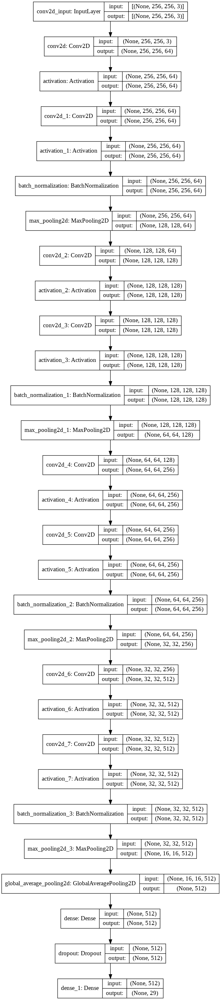

In [ ]:
plot_model(model,show_shapes=True)

#### Model Summary

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 256, 256, 64)      1792      
_________________________________________________________________
activation (Activation)      (None, 256, 256, 64)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 256, 256, 64)      36928     
_________________________________________________________________
activation_1 (Activation)    (None, 256, 256, 64)      0         
_________________________________________________________________
batch_normalization (BatchNo (None, 256, 256, 64)      256       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 128, 128, 128)     7

In [ ]:
filepath = '/content/drive/MyDrive/GA/Capstone/model_checkpoints/custom-model-{epoch:02d}-{val_accuracy:.2f}.hdf5'
checkpoint = ModelCheckpoint(filepath,monitor='val_accuracy',save_best_only=True,mode='max')


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss',patience=3)

In [ ]:
callbacks_list =[early_stopping,checkpoint]

In [ ]:
#model.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/custom-model-29-0.47.hdf5')

In [ ]:
history_model = model.fit(x=train_batches,steps_per_epoch=764,validation_data=validation_batches,validation_steps=87,epochs=100,callbacks=callbacks_list)

Epoch 1/100
764/764 [==============================] - 776s 1s/step - loss: 3.0196 - accuracy: 0.1733 - val_loss: 2.5566 - val_accuracy: 0.2888
Epoch 2/100
764/764 [==============================] - 752s 983ms/step - loss: 2.4245 - accuracy: 0.3226 - val_loss: 2.2216 - val_accuracy: 0.3860
Epoch 3/100
764/764 [==============================] - 755s 987ms/step - loss: 2.1774 - accuracy: 0.3902 - val_loss: 2.0290 - val_accuracy: 0.4302
Epoch 4/100
764/764 [==============================] - 755s 987ms/step - loss: 2.0086 - accuracy: 0.4341 - val_loss: 1.8810 - val_accuracy: 0.4657
Epoch 5/100
764/764 [==============================] - 755s 988ms/step - loss: 1.8772 - accuracy: 0.4698 - val_loss: 1.7955 - val_accuracy: 0.4925
Epoch 6/100
764/764 [==============================] - 755s 988ms/step - loss: 1.7836 - accuracy: 0.4941 - val_loss: 1.7042 - val_accuracy: 0.5203
Epoch 7/100
764/764 [==============================] - 755s 988ms/step - loss: 1.6905 - accuracy: 0.5195 - val_loss: 1.62

In [ ]:
pd.DataFrame(history_model.history).to_csv('custom_hostory.csv')

In [ ]:
model.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/custom-model-27-0.72.hdf5')

#### Evaluation

The model that was selected was one at epoch 27. This was chosen due to the fact that the difference in the validation accuracy was not very different from the the epochs before earlystopping callback stopped the training. At that point, the model was well overfitted. At the 27th epoch the model achieved 0.78 accuracy on the training set and 0.72 on the validation set. This shows that the model was still overfitted and wouldn't generalise very well. This was further shown by evaluating the model against the unseen test set during which the model only scored 0.63 accuracy.

In [ ]:
model.evaluate(test_batches)

6/6 [==============================] - 5s 793ms/step - loss: 1.2893 - accuracy: 0.6328


[1.289307713508606, 0.632758617401123]

##### **Epoch Accuracy and Loss**

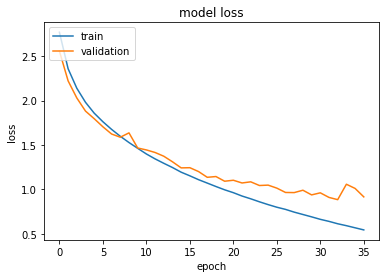

In [ ]:
plt.plot(history_model.history['loss'])
plt.plot(history_model.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

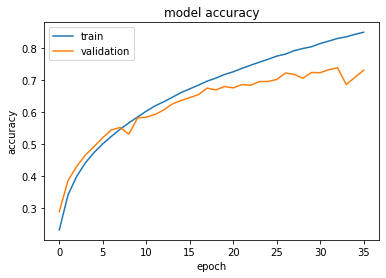

In [ ]:
plt.plot(history_model.history['accuracy'])
plt.plot(history_model.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
test_batches.classes

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

In [ ]:
y_preds = np.array([np.argmax(p) for p in model.predict(test_batches)])
y_preds

array([ 0,  0,  0,  0,  0,  0, 11,  0,  4, 28,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  9,  1,  1,  1,  1,  1,  9,  1,  1,  1,  1,  1,
       27,  1,  1,  1, 15,  1,  2,  2,  8,  2,  0, 18,  2, 18,  2,  2,  2,
       18,  2, 15,  2,  2,  2,  2, 18,  2,  0, 13,  3, 15,  3,  3, 18, 18,
       10,  3,  3,  3, 10,  3, 15, 15,  3,  3,  3,  3,  4,  4, 18,  4, 15,
       15,  4, 18,  4, 23,  4, 18,  4, 18,  9, 10,  4,  4,  4, 17,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5, 28,
       24,  6,  6,  6, 17,  6,  6,  6,  6,  6,  7, 22,  6, 18,  6, 18,  3,
        6,  6,  6,  8,  7, 28,  7, 18,  4,  7, 18,  7,  7,  7,  7,  3, 10,
        7,  7, 18,  7,  3,  7, 13,  8,  8,  8,  3,  2,  8, 12,  2,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  4,  9,  9,  9,  9, 10, 10, 18, 18,
       10, 10, 10, 10, 10, 10,  7, 10,  0, 10, 27,  7,  7, 10, 10,  7, 11,
       18,  1,  1, 11, 17

##### **Confusion Matrix**

In [ ]:
cm = confusion_matrix(test_batches.classes,y_preds)

Text(122.09375, 0.5, 'true label')

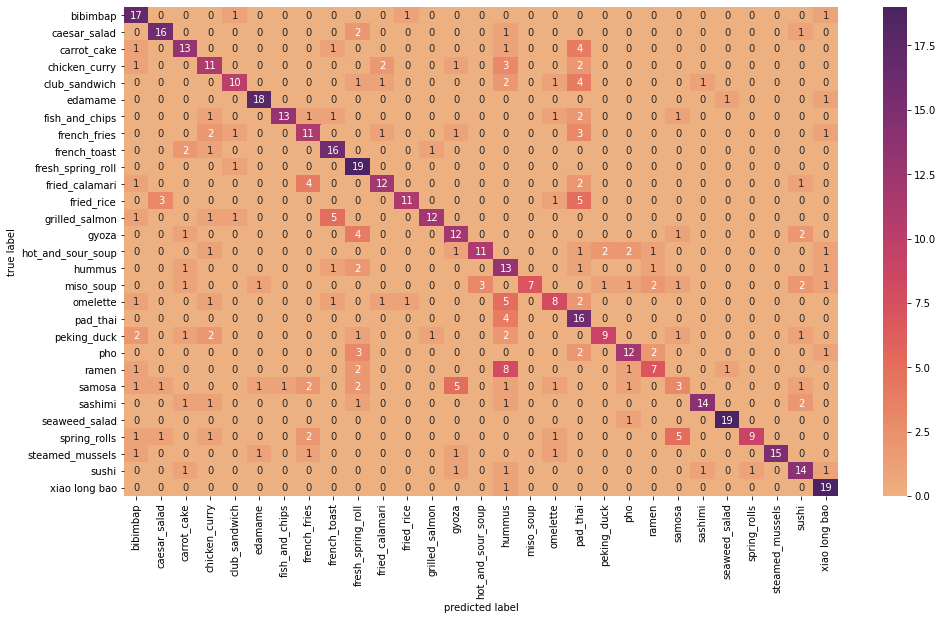

In [ ]:
df_cm = pd.DataFrame(cm, index = food_labels,
                  columns = food_labels)
plt.figure(figsize = (16,9))
sns.heatmap(df_cm, annot=True,cmap='flare')
plt.xlabel('predicted label')
plt.ylabel('true label')

The heatmap above shows the true label vs predicted label across the 29 food categories. It can be seen that the categories that performed the worst was samosa with only 3/20 correct predictions. The model predicted that they were gyoza, spring rolls and french fries. 

##### **Accuracy**

Top N accuracy measures how often the predicted class falls in the top N values of your softmax distribution. Top 1 accuracy is the same as the accuracy score when the model is evaluated using model.evaluate(samples) function.

In [ ]:
top_1_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=1)
top_1_accuracy.update_state(to_categorical(test_batches.classes),model.predict(test_batches))
top_1_accuracy.result().numpy()

0.6327586

In [ ]:
top_2_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=2)
top_2_accuracy.update_state(to_categorical(test_batches.classes),model.predict(test_batches))
top_2_accuracy.result().numpy()

0.7413793

In [ ]:
top_3_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=3)
top_3_accuracy.update_state(to_categorical(test_batches.classes),model.predict(test_batches))
top_3_accuracy.result().numpy()

0.82586205

In [ ]:
top_5_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=5)
top_5_accuracy.update_state(to_categorical(test_batches.classes),model.predict(test_batches))
top_5_accuracy.result().numpy()

0.8862069

### VGG16

#### Description

This model uses transfer learning to finetune the original VGG16 model that was trained on the ImageNet dataset. The preprocessing technique that was used for the model is **VGG16 Preprocessing**. The model has 16 layers and  ~120k parameters to finetune.

In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=train_path,target_size=(224,224),classes=food_labels,batch_size=100)
validation_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=validation_path,target_size=(224,224),classes=food_labels,batch_size=100)
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=test_path,target_size=(224,224),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 76345 images belonging to 29 classes.
Found 8699 images belonging to 29 classes.
Found 580 images belonging to 29 classes.


In [ ]:
#Function to create vgg16 model
def create_vgg16():
  vgg16_original = VGG16()
  vgg16_ft = Sequential()
  for layer in vgg16_original.layers[:-1]:
    vgg16_ft.add(layer)
  for layer in vgg16_ft.layers:
    layer.trainable=False
  vgg16_ft.add(Dropout(0.1))
  vgg16_ft.add(Dense(29,activation='softmax'))
  vgg16_ft.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])
  return vgg16_ft

In [ ]:
vgg16_ft = create_vgg16()

##### Model Diagram

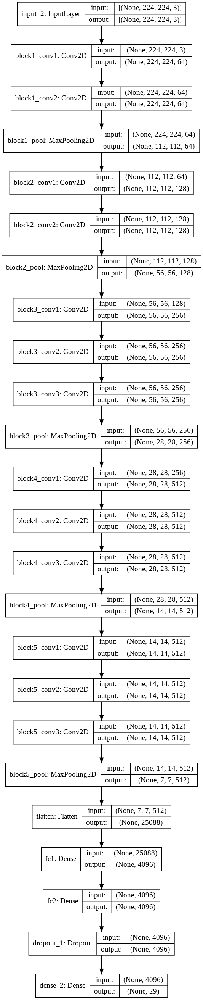

In [ ]:
plot_model(vgg16_ft,show_shapes=True)

##### Model Summary

In [ ]:
vgg16_ft.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 56, 56, 256)      

In [ ]:
filepath = '/content/drive/MyDrive/GA/Capstone/model_checkpoints/vgg16-{epoch:02d}-{val_accuracy:.2f}.hdf5'
checkpoint = ModelCheckpoint(filepath,monitor='val_accuracy',save_best_only=True,mode='max')


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss',patience=3)

In [ ]:
callbacks_list =[checkpoint,early_stopping]

In [ ]:
history_vgg16_ft = vgg16_ft.fit(x=train_batches, steps_per_epoch=764,validation_data=validation_batches, validation_steps=87, epochs=100, callbacks=callbacks_list)

Epoch 1/100
764/764 [==============================] - 582s 730ms/step - loss: 1.4566 - accuracy: 0.6024 - val_loss: 0.9556 - val_accuracy: 0.7311
Epoch 2/100
764/764 [==============================] - 524s 686ms/step - loss: 0.7927 - accuracy: 0.7661 - val_loss: 0.8515 - val_accuracy: 0.7557
Epoch 3/100
764/764 [==============================] - 471s 617ms/step - loss: 0.6472 - accuracy: 0.8029 - val_loss: 0.8310 - val_accuracy: 0.7648
Epoch 4/100
764/764 [==============================] - 485s 635ms/step - loss: 0.5694 - accuracy: 0.8229 - val_loss: 0.8373 - val_accuracy: 0.7660
Epoch 5/100
764/764 [==============================] - 463s 605ms/step - loss: 0.5229 - accuracy: 0.8341 - val_loss: 0.8174 - val_accuracy: 0.7749
Epoch 6/100
764/764 [==============================] - 467s 611ms/step - loss: 0.4942 - accuracy: 0.8418 - val_loss: 0.8471 - val_accuracy: 0.7745
Epoch 7/100
764/764 [==============================] - 453s 592ms/step - loss: 0.4637 - accuracy: 0.8523 - val_loss: 0

In [ ]:
vgg16_ft.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/vgg16-05-0.77.hdf5')

##### Evaluation

The model that was selected was one at epoch 5. This was chosen due to the fact that the difference in the validation accuracy was not very different from the the epochs before earlystopping callback stopped the training. At that point, the model was well overfitted. At the 5th epoch the model achieved 0.83 accuracy on the training set and 0.77 on the validation set. This shows that the model was still slightly overfitted. This was further shown by evaluating the model against the unseen test set during which the model scored 0.67 accuracy.

###### **Epoch Accuracy and Loss**

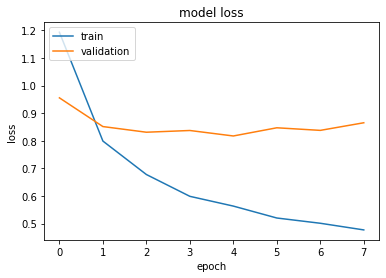

In [ ]:
plt.plot(history_vgg16_ft.history['loss'])
plt.plot(history_vgg16_ft.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

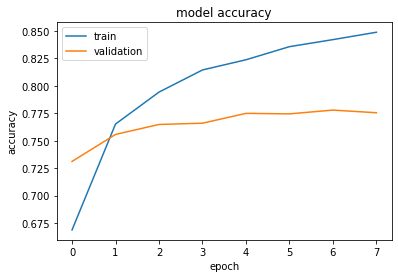

In [ ]:
plt.plot(history_vgg16_ft.history['accuracy'])
plt.plot(history_vgg16_ft.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=test_path,target_size=(224,224),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 580 images belonging to 29 classes.


###### **Accuracy**

Top N accuracy measures how often the predicted class falls in the top N values of your softmax distribution. Top 1 accuracy is the same as the accuracy score when the model is evaluated using model.evaluate(samples) function.

In [ ]:
top_1_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=1)
top_1_accuracy.update_state(to_categorical(test_batches.classes),vgg16_ft.predict(test_batches))
top_1_accuracy.result().numpy()

0.67142856

In [ ]:
top_2_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=2)
top_2_accuracy.update_state(to_categorical(test_batches.classes),vgg16_ft.predict(test_batches))
top_2_accuracy.result().numpy()

0.79642856

In [ ]:
top_3_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=3)
top_3_accuracy.update_state(to_categorical(test_batches.classes),vgg16_ft.predict(test_batches))
top_3_accuracy.result().numpy()

0.8464286

In [ ]:
top_5_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=5)
top_5_accuracy.update_state(to_categorical(test_batches.classes),vgg16_ft.predict(test_batches))
top_5_accuracy.result().numpy()

0.9142857

### VGG16 with Dropout

#### Description

This model is similar to the previous previous VGG16 model. The difference is the larger Dropout (0.5) in the fully connected layers to help with the previous model's overfitting problem.

In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=train_path,target_size=(224,224),classes=food_labels,batch_size=100)
validation_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=validation_path,target_size=(224,224),classes=food_labels,batch_size=100)
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=test_path,target_size=(224,224),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 76345 images belonging to 29 classes.
Found 8699 images belonging to 29 classes.
Found 580 images belonging to 29 classes.


In [ ]:
def create_vgg16_dropout():
  vgg16_original = VGG16()
  vgg16_ft = Sequential()
  for layer in vgg16_original.layers[:-4]:
    vgg16_ft.add(layer)
  for layer in vgg16_ft.layers:
    layer.trainable=False
  vgg16_ft.add(GlobalAveragePooling2D())
  vgg16_ft.add(Dense(1024,activation='relu'))
  vgg16_ft.add(Dropout(0.5))
  vgg16_ft.add(Dense(29,activation='softmax'))
  vgg16_ft.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])
  return vgg16_ft

In [ ]:
vgg16_dropout_ft = create_vgg16_dropout()

#### Model Diagram

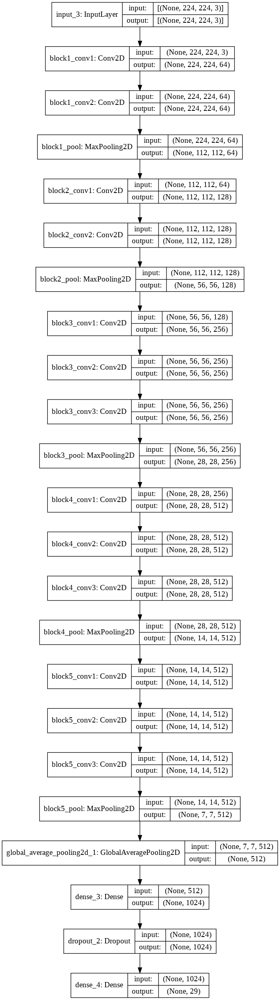

In [ ]:
plot_model(vgg16_dropout_ft,show_shapes=True)

#### Model Summary

In [ ]:
vgg16_dropout_ft.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 56, 56, 256)      

In [ ]:
filepath = '/content/drive/MyDrive/GA/Capstone/model_checkpoints/vgg16-dropout-{epoch:02d}-{val_accuracy:.2f}.hdf5'
checkpoint = ModelCheckpoint(filepath,monitor='val_accuracy',save_best_only=True,mode='max')


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss',patience=3)

In [ ]:
callbacks_list =[checkpoint,early_stopping]

In [ ]:
history_vgg16_dropout_ft = vgg16_dropout_ft.fit(x=train_batches, steps_per_epoch=764,validation_data=validation_batches, validation_steps=87, epochs=100, callbacks=callbacks_list)

Epoch 1/100
764/764 [==============================] - 423s 552ms/step - loss: 2.3051 - accuracy: 0.5176 - val_loss: 0.8318 - val_accuracy: 0.7627
Epoch 2/100
764/764 [==============================] - 410s 537ms/step - loss: 1.0107 - accuracy: 0.7056 - val_loss: 0.7579 - val_accuracy: 0.7796
Epoch 3/100
764/764 [==============================] - 412s 540ms/step - loss: 0.9157 - accuracy: 0.7317 - val_loss: 0.7157 - val_accuracy: 0.7965
Epoch 4/100
764/764 [==============================] - 427s 558ms/step - loss: 0.8499 - accuracy: 0.7471 - val_loss: 0.6920 - val_accuracy: 0.7993
Epoch 5/100
764/764 [==============================] - 427s 558ms/step - loss: 0.7894 - accuracy: 0.7670 - val_loss: 0.6611 - val_accuracy: 0.8118
Epoch 6/100
764/764 [==============================] - 426s 557ms/step - loss: 0.7631 - accuracy: 0.7738 - val_loss: 0.6492 - val_accuracy: 0.8127
Epoch 7/100
764/764 [==============================] - 427s 559ms/step - loss: 0.7186 - accuracy: 0.7869 - val_loss: 0

In [ ]:
pd.DataFrame(history_vgg16_dropout_ft.history).to_csv('history_vgg16_dropout_ft.csv')

In [ ]:
vgg16_dropout_ft.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/vgg16-dropout-12-0.84.hdf5')

#### Evaluation


The model that was selected was one at epoch 12. This was chosen due to the fact that the difference in the validation accuracy was not very different from the the epochs before earlystopping callback stopped the training. At that point, the model was well overfitted. At the 12th epoch the model achieved 0.81 accuracy on the training set and 0.84 on the validation set. Here, the validation accuracy is higher than the training accuracy due to the fact that there is a large dropout during training which affects the accuracy during training.

##### **Epoch Accuracy and Loss**

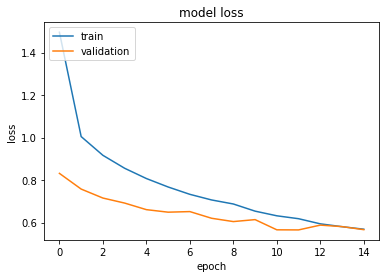

In [ ]:
plt.plot(history_vgg16_dropout_ft.history['loss'])
plt.plot(history_vgg16_dropout_ft.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

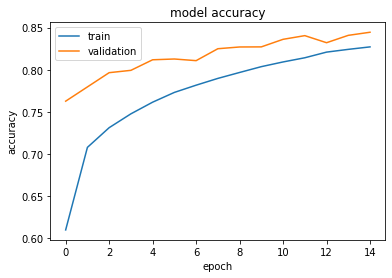

In [ ]:
plt.plot(history_vgg16_dropout_ft.history['accuracy'])
plt.plot(history_vgg16_dropout_ft.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input).flow_from_directory(directory=test_path,target_size=(224,224),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 580 images belonging to 29 classes.


In [ ]:
test_batches.classes

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

In [ ]:
y_preds = np.array([np.argmax(p) for p in vgg16_dropout_ft.predict(test_batches)])
y_preds

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0, 21, 21,  0,  0,  0,  0,  0,  0,
        0,  0,  0, 11, 24,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, 24,  1,
        1,  1, 12,  1, 15,  1,  2,  8, 13,  2,  2,  8,  2,  2,  2,  2,  8,
        2,  2,  8,  8,  2,  8,  8,  2,  2,  0, 16, 28, 21,  3,  3,  3,  3,
        9,  3,  3, 25,  3,  3, 20,  3,  3,  3,  3,  3,  4,  4,  4, 22,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  8,  5,  5,
        5,  5,  5,  5,  5,  5, 24,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
       26,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6, 13,  7,  7,  7,  7,  4,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8, 13,  8,  8, 25,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  6,  6, 10,  7,
       10,  2, 10, 10, 10, 10,  7, 10, 10, 10,  7,  6, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 18

##### **Confusion Matrix**

In [ ]:
cm = confusion_matrix(test_batches.classes,y_preds)

Text(122.09375, 0.5, 'true label')

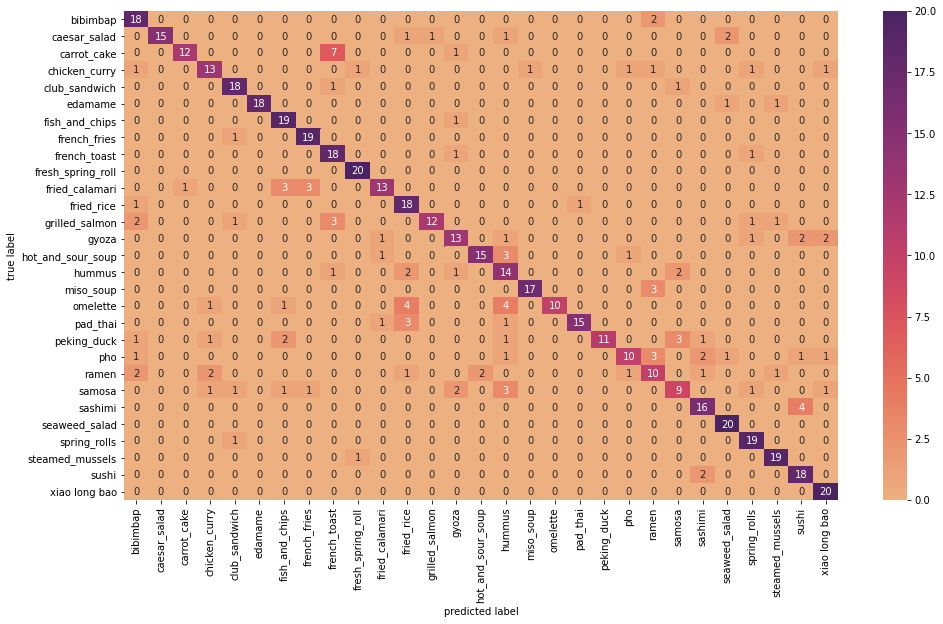

In [ ]:
df_cm = pd.DataFrame(cm, index = food_labels,
                  columns = food_labels)
plt.figure(figsize = (16,9))
sns.heatmap(df_cm, annot=True,cmap='flare')
plt.xlabel('predicted label')
plt.ylabel('true label')

The diagram above shows the true label vs predicted label across the categories. Again, samosa is the category that the model seem to struggle with similar to the `Custom Model`. However, this model performed better at 9/20 for samosa images.

##### **Accuracy**

Top N accuracy measures how often the predicted class falls in the top N values of your softmax distribution. Top 1 accuracy is the same as the accuracy score when the model is evaluated using model.evaluate(samples) function.

In [ ]:
top_1_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=1)
top_1_accuracy.update_state(to_categorical(test_batches.classes),vgg16_dropout_ft.predict(test_batches))
top_1_accuracy.result().numpy()

0.7741379

In [ ]:
top_2_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=2)
top_2_accuracy.update_state(to_categorical(test_batches.classes),vgg16_dropout_ft.predict(test_batches))
top_2_accuracy.result().numpy()

0.8724138

In [ ]:
top_3_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=3)
top_3_accuracy.update_state(to_categorical(test_batches.classes),vgg16_dropout_ft.predict(test_batches))
top_3_accuracy.result().numpy()

0.91206896

In [ ]:
top_5_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=5)
top_5_accuracy.update_state(to_categorical(test_batches.classes),vgg16_dropout_ft.predict(test_batches))
top_5_accuracy.result().numpy()

0.96034485

The numbers above show that the model generalised better than the previous two models across all the Top-N accuracies.

### Inception V3 with Dropout

#### Description

This model uses transfer learning to finetune the original Inception V3 model that was trained on the ImageNet dataset with a 0.5 Dropout in the fully connected layer. The preprocessing technique that was used for the model is Inception V3 Preprocessing. The model has 49 layers and ~2m parameters to finetune.

In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input
).flow_from_directory(directory=train_path,target_size=(299,299),classes=food_labels,batch_size=100)

validation_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input
).flow_from_directory(directory=validation_path,target_size=(299,299),classes=food_labels,batch_size=100)

test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input
).flow_from_directory(directory=test_path,target_size=(299,299),classes=food_labels,batch_size=100,seed=42,shuffle=False)

In [ ]:
def create_inception_v3_dropout():
  inception_original = InceptionV3(weights='imagenet', include_top=False)
  x = inception_original.output
  x = GlobalAveragePooling2D()(x)
  x = Dense(1024, activation='relu')(x)
  x = Dropout(0.5)(x)
  predictions = Dense(29, activation='softmax')(x)
  inceptionv3_ft = Model(inputs=inception_original.input, outputs=predictions)
  for layer in inception_original.layers:
    layer.trainable = False
  inceptionv3_ft.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
  return inceptionv3_ft

In [ ]:
inceptionv3_dropout_ft = create_inception_v3_dropout()

#### Model Diagram

In [ ]:
plot_model(inceptionv3_dropout_ft, show_shapes=True)

#### Model Summary

In [ ]:
inceptionv3_dropout_ft.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_188 (Conv2D)             (None, None, None, 3 864         input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_188 (BatchN (None, None, None, 3 96          conv2d_188[0][0]                 
__________________________________________________________________________________________________
activation_188 (Activation)     (None, None, None, 3 0           batch_normalization_188[0][0]    
____________________________________________________________________________________________

In [ ]:
filepath = '/content/drive/MyDrive/GA/Capstone/model_checkpoints/inceptionv3-dropout-{epoch:02d}-{val_accuracy:.2f}.hdf5'
checkpoint = ModelCheckpoint(filepath,monitor='val_accuracy',save_best_only=True,mode='max')


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss',patience=3)

In [ ]:
callbacks_list =[early_stopping,checkpoint]

In [ ]:
inceptionv3_dropout_history = inceptionv3_dropout_ft.fit(x=train_batches,epochs=100,steps_per_epoch=764,callbacks=callbacks_list,validation_data=validation_batches,validation_steps=87)

Epoch 1/100
764/764 [==============================] - 527s 664ms/step - loss: 1.4221 - accuracy: 0.5923 - val_loss: 0.7814 - val_accuracy: 0.7709
Epoch 2/100
764/764 [==============================] - 441s 577ms/step - loss: 0.8898 - accuracy: 0.7361 - val_loss: 0.7277 - val_accuracy: 0.7876
Epoch 3/100
764/764 [==============================] - 431s 564ms/step - loss: 0.8029 - accuracy: 0.7601 - val_loss: 0.6734 - val_accuracy: 0.8004
Epoch 4/100
764/764 [==============================] - 429s 561ms/step - loss: 0.7501 - accuracy: 0.7733 - val_loss: 0.6549 - val_accuracy: 0.8108
Epoch 5/100
764/764 [==============================] - 431s 564ms/step - loss: 0.7083 - accuracy: 0.7877 - val_loss: 0.6105 - val_accuracy: 0.8203
Epoch 6/100
764/764 [==============================] - 432s 565ms/step - loss: 0.6684 - accuracy: 0.7958 - val_loss: 0.5941 - val_accuracy: 0.8246
Epoch 7/100
764/764 [==============================] - 444s 581ms/step - loss: 0.6447 - accuracy: 0.8024 - val_loss: 0

In [ ]:
pd.DataFrame(inceptionv3_dropout_history.history).to_csv('inceptionv3_dropout_history.csv')

#### Evaluation


The model that was selected was one at epoch 19. This was chosen due to the fact that the difference in the validation accuracy was not very different from the the epochs before earlystopping callback stopped the training. At that point, the model was well overfitted. At the 19th epoch the model achieved 0.86 accuracy on the training set and 0.85 on the validation set. 

##### **Epoch Accuracy and Loss**

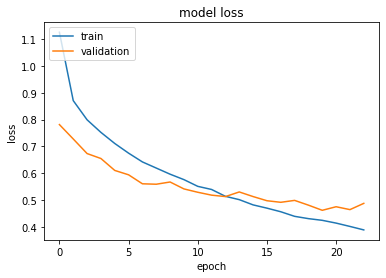

In [ ]:
plt.plot(inceptionv3_dropout_history.history['loss'])
plt.plot(inceptionv3_dropout_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

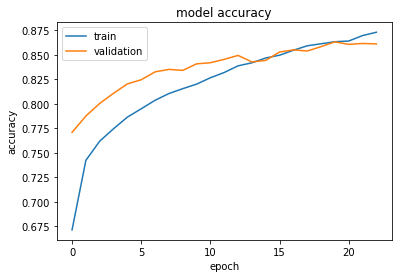

In [ ]:
plt.plot(inceptionv3_dropout_history.history['accuracy'])
plt.plot(inceptionv3_dropout_history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
inceptionv3_dropout_ft = create_inception_v3_dropout()

87916544/87910968 [==============================] - 1s 0us/step


In [ ]:
inceptionv3_dropout_ft.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/inceptionv3-dropout-19-0.86.hdf5')

In [ ]:
#Saving Full Model (Best Model)
tf.keras.models.save_model(inceptionv3_dropout_ft,'best_model.hdf5')

In [ ]:
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input).flow_from_directory(directory=test_path,target_size=(299,299),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 580 images belonging to 29 classes.


In [ ]:
test_batches.classes

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

In [ ]:
y_preds = np.array([np.argmax(p) for p in inceptionv3_dropout_ft.predict(test_batches)])
y_preds

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1, 17,  1,  1,  1,  1,  1,  1,  0,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  2,  8,  2,  2,  2,  2,  2,  2,  2,  2, 15,
        2,  2,  8,  2,  2,  2,  8,  2,  2,  0, 22,  3, 21,  3,  3,  3,  3,
        2,  1,  3,  3, 17,  3, 20,  3,  3,  3,  3,  3,  4,  4,  4, 22,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  7,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6, 28,  6,  6,  6,  6,  7,  6,  6,  6,  6,  6,  6,
       25,  6,  6, 13,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  8,  7,  7,  8,  8,  8,  8,  8,  8, 17, 12,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10,  3,
       10,  3, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

##### **Confusion Matrix**

In [ ]:
cm = confusion_matrix(test_batches.classes,y_preds)

Text(122.09375, 0.5, 'true label')

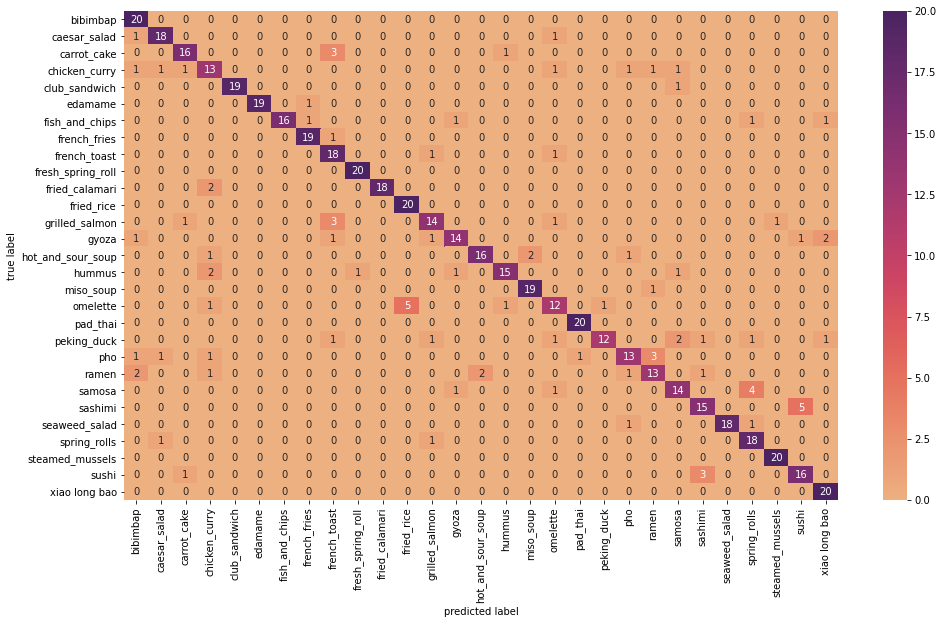

In [ ]:
df_cm = pd.DataFrame(cm, index = food_labels,
                  columns = food_labels)
plt.figure(figsize = (16,9))
sns.heatmap(df_cm, annot=True,cmap='flare')
plt.xlabel('predicted label')
plt.ylabel('true label')

##### **Accuracy**

In [ ]:
top_1_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=1)
top_1_accuracy.update_state(to_categorical(test_batches.classes),inceptionv3_dropout_ft.predict(test_batches))
top_1_accuracy.result().numpy()

0.8362069

In [ ]:
top_2_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=2)
top_2_accuracy.update_state(to_categorical(test_batches.classes),inceptionv3_dropout_ft.predict(test_batches))
top_2_accuracy.result().numpy()

0.92413795

In [ ]:
top_3_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=3)
top_3_accuracy.update_state(to_categorical(test_batches.classes),inceptionv3_dropout_ft.predict(test_batches))
top_3_accuracy.result().numpy()

0.9517241

In [ ]:
top_5_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=5)
top_5_accuracy.update_state(to_categorical(test_batches.classes),inceptionv3_dropout_ft.predict(test_batches))
top_5_accuracy.result().numpy()

0.9741379

### Inception V3 GAP

#### Description

This model is similar to the previous Inception V3 Model but instead of having a small fully connected layer at the top, we connect the softmax layer directly to the global average pooling layer. The preprocessing technique that was used for the model is Inception V3 Preprocessing. The model has 48 layers and ~60k parameters to finetune.

In [ ]:
def create_inception_v3_no_fc():
  inception_original = InceptionV3(weights='imagenet', include_top=False)
  x = inception_original.output
  x = GlobalAveragePooling2D()(x)
  predictions = Dense(29, activation='softmax')(x)
  inceptionv3_ft = Model(inputs=inception_original.input, outputs=predictions)
  for layer in inception_original.layers:
    layer.trainable = False
  inceptionv3_ft.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
  return inceptionv3_ft

In [ ]:
inceptionv3_dropout_ft = create_inception_v3_no_fc()

#### Model Diagram

In [ ]:
plot_model(inceptionv3_dropout_ft, show_shapes=True)

#### Model Summary

In [ ]:
inceptionv3_dropout_ft.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_188 (Conv2D)             (None, None, None, 3 864         input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_188 (BatchN (None, None, None, 3 96          conv2d_188[0][0]                 
__________________________________________________________________________________________________
activation_188 (Activation)     (None, None, None, 3 0           batch_normalization_188[0][0]    
____________________________________________________________________________________________

In [ ]:
filepath = '/content/drive/MyDrive/GA/Capstone/model_checkpoints/inceptionv3-no-fc-{epoch:02d}-{val_accuracy:.2f}.hdf5'
checkpoint = ModelCheckpoint(filepath,monitor='val_accuracy',save_best_only=True,mode='max')


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss',patience=3)

In [ ]:
callbacks_list =[early_stopping,checkpoint]

In [ ]:
inceptionv3_dropout_history = inceptionv3_dropout_ft.fit(x=train_batches,epochs=100,steps_per_epoch=764,callbacks=callbacks_list,validation_data=validation_batches,validation_steps=87)

Epoch 1/100
764/764 [==============================] - 529s 666ms/step - loss: 1.4168 - accuracy: 0.6240 - val_loss: 0.7743 - val_accuracy: 0.7805
Epoch 2/100
764/764 [==============================] - 438s 573ms/step - loss: 0.7172 - accuracy: 0.7935 - val_loss: 0.6871 - val_accuracy: 0.8043
Epoch 3/100
764/764 [==============================] - 427s 559ms/step - loss: 0.6216 - accuracy: 0.8202 - val_loss: 0.6476 - val_accuracy: 0.8120
Epoch 4/100
764/764 [==============================] - 427s 559ms/step - loss: 0.5702 - accuracy: 0.8342 - val_loss: 0.6299 - val_accuracy: 0.8195
Epoch 5/100
764/764 [==============================] - 427s 559ms/step - loss: 0.5382 - accuracy: 0.8418 - val_loss: 0.6007 - val_accuracy: 0.8260
Epoch 6/100
764/764 [==============================] - 429s 561ms/step - loss: 0.5023 - accuracy: 0.8529 - val_loss: 0.6034 - val_accuracy: 0.8268
Epoch 7/100
764/764 [==============================] - 433s 567ms/step - loss: 0.4792 - accuracy: 0.8583 - val_loss: 0

In [ ]:
pd.DataFrame(inceptionv3_dropout_history.history).to_csv('inceptionv3_no_fc_history.csv')

#### Evaluation

The model that was selected was one at epoch 4. This was chosen due to the fact that the difference in the validation accuracy was not very different from the the epochs before earlystopping callback stopped the training. At that point, the model was well overfitted. At the 4th epoch the model achieved 0.83 accuracy on the training set and 0.81 on the validation set.

##### **Epoch Accuracy and Loss**

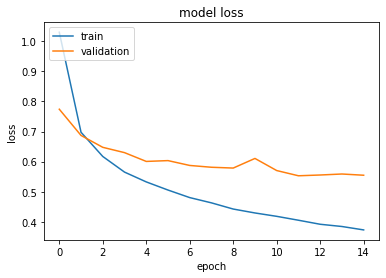

In [ ]:
plt.plot(inceptionv3_dropout_history.history['loss'])
plt.plot(inceptionv3_dropout_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

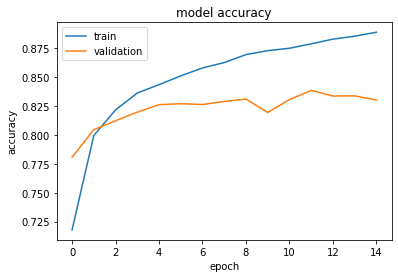

In [ ]:
plt.plot(inceptionv3_dropout_history.history['accuracy'])
plt.plot(inceptionv3_dropout_history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
inceptionv3_ft = create_inception_v3_no_fc()


In [ ]:
inceptionv3_ft.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/inceptionv3-no-fc-04-0.82.hdf5')

In [ ]:
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input).flow_from_directory(directory=test_path,target_size=(299,299),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 580 images belonging to 29 classes.


In [ ]:
test_batches.classes

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

In [ ]:
y_preds = np.array([np.argmax(p) for p in inceptionv3_ft.predict(test_batches)])
y_preds

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1, 17,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1, 17,  1,  2,  8, 15,  2,  2,  2,  2,  2,  2,  2,  8,
        2,  2,  8,  8,  2,  2,  8,  2,  2,  0, 22,  3, 21,  3,  3,  3,  3,
       14,  3,  3,  3,  3,  3, 20,  3,  3,  3,  3,  3,  4,  4,  4, 22,  4,
        4,  4,  4,  4,  9,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  7,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6, 17,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8, 27,  8,  8,  8,  8, 17, 12,  8,  8,
       27,  8,  8,  8,  8,  8,  8,  8, 13,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10,  6, 10, 10, 11,
       11,  0, 11, 11, 11

##### **Confusion Matrix**

In [ ]:
cm = confusion_matrix(test_batches.classes,y_preds)

Text(122.09375, 0.5, 'true label')

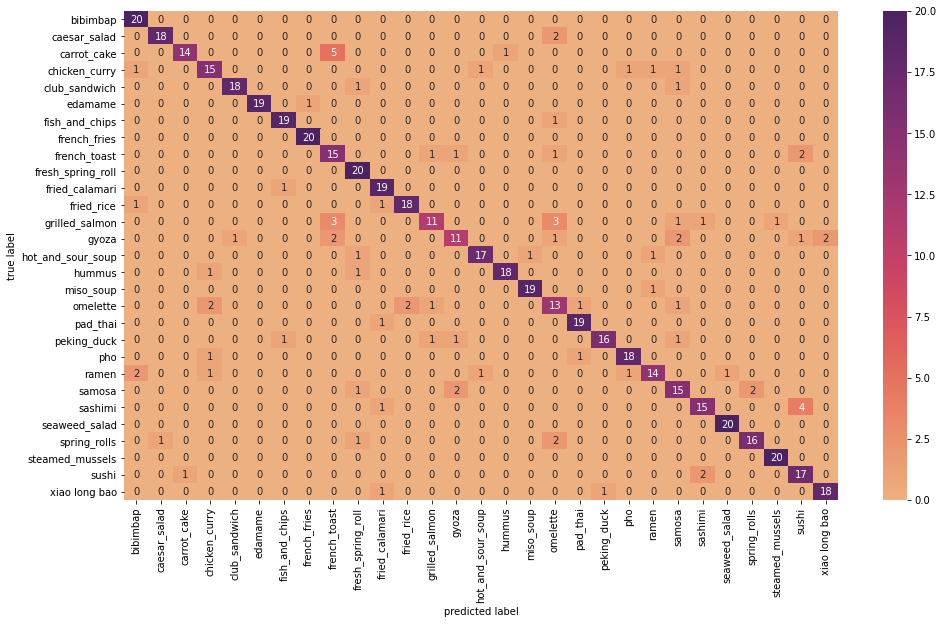

In [ ]:
df_cm = pd.DataFrame(cm, index = food_labels,
                  columns = food_labels)
plt.figure(figsize = (16,9))
sns.heatmap(df_cm, annot=True,cmap='flare')
plt.xlabel('predicted label')
plt.ylabel('true label')

##### **Accuracy**

In [ ]:
top_1_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=1)
top_1_accuracy.update_state(to_categorical(test_batches.classes),inceptionv3_ft.predict(test_batches))
top_1_accuracy.result().numpy()

0.84827584

In [ ]:
top_2_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=2)
top_2_accuracy.update_state(to_categorical(test_batches.classes),inceptionv3_ft.predict(test_batches))
top_2_accuracy.result().numpy()

0.92413795

In [ ]:
top_3_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=3)
top_3_accuracy.update_state(to_categorical(test_batches.classes),inceptionv3_ft.predict(test_batches))
top_3_accuracy.result().numpy()

0.95862067

In [ ]:
top_5_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=5)
top_5_accuracy.update_state(to_categorical(test_batches.classes),inceptionv3_ft.predict(test_batches))
top_5_accuracy.result().numpy()

0.98448277

### ResNet50

#### Description

This model uses transfer learning to finetune the original RestNet model that was trained on the ImageNet dataset. The preprocessing technique that was used for the model is **Inception V3 Preprocessing**. The model has 50 layers and ~60k parameters to finetune.

In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.resnet.preprocess_input
).flow_from_directory(directory=train_path,target_size=(224,224),classes=food_labels,batch_size=100)

validation_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.resnet.preprocess_input
).flow_from_directory(directory=validation_path,target_size=(224,224),classes=food_labels,batch_size=100)

test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.resnet.preprocess_input
).flow_from_directory(directory=test_path,target_size=(224,224),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 76345 images belonging to 29 classes.
Found 8699 images belonging to 29 classes.
Found 580 images belonging to 29 classes.


In [ ]:
def create_resnet50():
  resnet_original = ResNet50(weights='imagenet',include_top=False)
  x = resnet_original.output
  x = GlobalAveragePooling2D()(x)
  prediction = Dense(29, activation='softmax')(x)
  resnet = Model(inputs=resnet_original.input, outputs=prediction)
  for layer in resnet_original.layers:
    layer.trainable = False
  resnet.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])
  return resnet

In [ ]:
resnet50 = create_resnet50()

94773248/94765736 [==============================] - 1s 0us/step


#### Model Diagram

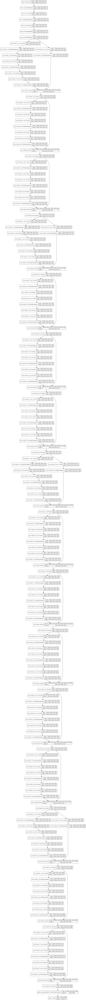

In [ ]:
plot_model(resnet50,show_shapes=True)

#### Model Summary

In [ ]:
resnet50.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, None, None, 3 0           input_8[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, None, None, 6 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, None, None, 6 256         conv1_conv[0][0]                 
____________________________________________________________________________________________

In [ ]:
filepath = '/content/drive/MyDrive/GA/Capstone/model_checkpoints/resnet50-{epoch:02d}-{val_accuracy:.2f}.hdf5'
checkpoint = ModelCheckpoint(filepath,monitor='val_accuracy',save_best_only=True,mode='max')


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss',patience=3)

In [ ]:
callbacks_list =[early_stopping,checkpoint]

In [ ]:
resnet50_history = resnet50.fit(x=train_batches,epochs=100,steps_per_epoch=764,callbacks=callbacks_list,validation_data=validation_batches,validation_steps=87)

Epoch 1/100
764/764 [==============================] - 438s 570ms/step - loss: 1.2716 - accuracy: 0.6502 - val_loss: 0.6461 - val_accuracy: 0.8157
Epoch 2/100
764/764 [==============================] - 404s 529ms/step - loss: 0.5758 - accuracy: 0.8313 - val_loss: 0.5703 - val_accuracy: 0.8365
Epoch 3/100
764/764 [==============================] - 402s 527ms/step - loss: 0.4631 - accuracy: 0.8628 - val_loss: 0.5232 - val_accuracy: 0.8431
Epoch 4/100
764/764 [==============================] - 402s 525ms/step - loss: 0.4006 - accuracy: 0.8814 - val_loss: 0.5062 - val_accuracy: 0.8477
Epoch 5/100
764/764 [==============================] - 401s 524ms/step - loss: 0.3569 - accuracy: 0.8926 - val_loss: 0.4675 - val_accuracy: 0.8598
Epoch 6/100
764/764 [==============================] - 400s 524ms/step - loss: 0.3241 - accuracy: 0.9021 - val_loss: 0.4605 - val_accuracy: 0.8614
Epoch 7/100
764/764 [==============================] - 399s 523ms/step - loss: 0.2950 - accuracy: 0.9121 - val_loss: 0

In [ ]:
pd.DataFrame(resnet50_history.history).to_csv('/content/drive/MyDrive/GA/Capstone/model_history/resnet50_history.csv')

#### Evaluation

The model that was selected was one at epoch 4. This was chosen due to the fact that the difference in the validation accuracy was not very different from the the epochs before earlystopping callback stopped the training. At that point, the model was well overfitted. At the 4th epoch the model achieved 0.88 accuracy on the training set and 0.84 on the validation set.

##### **Epoch Accuracy and Loss**

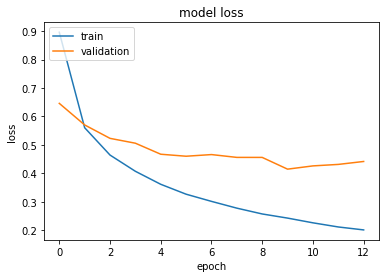

In [ ]:
plt.plot(resnet50_history.history['loss'])
plt.plot(resnet50_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

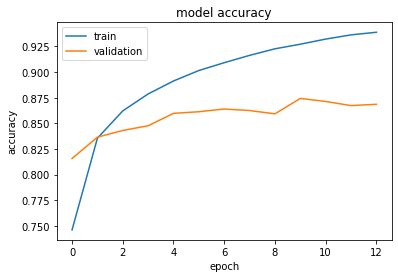

In [ ]:
plt.plot(resnet50_history.history['accuracy'])
plt.plot(resnet50_history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
resnet50 = create_resnet50()

In [ ]:
resnet50.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/resnet50-04-0.85.hdf5')

In [ ]:
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.resnet.preprocess_input
).flow_from_directory(directory=test_path,target_size=(224,224),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 580 images belonging to 29 classes.


In [ ]:
test_batches.classes

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

In [ ]:
y_preds = np.array([np.argmax(p) for p in resnet50.predict(test_batches)])
y_preds

array([ 0,  0,  0, 24,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  4,  1,  1,  1,  1,  1,
       11,  1,  1,  1, 15,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2, 12,  2,  2,  2,  8,  2,  2, 26, 15,  3, 21,  3,  3,  3,  3,
       11,  1,  3,  3,  3, 11,  3,  3,  3,  3,  0,  3,  4,  4,  4, 27,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  2,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  4,  6,  6,  6,  7,  6,  6,  6,  6,  6, 10,
        6,  6,  6, 13,  7,  7,  7,  7,  4,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  4,  8,  8,  8, 27,  8,  8, 12, 15,  4,  8,
        8,  8,  8,  8,  8,  8,  8, 15,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 18, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

##### **Confusion Matrix**

In [ ]:
cm = confusion_matrix(test_batches.classes,y_preds)

Text(122.09375, 0.5, 'true label')

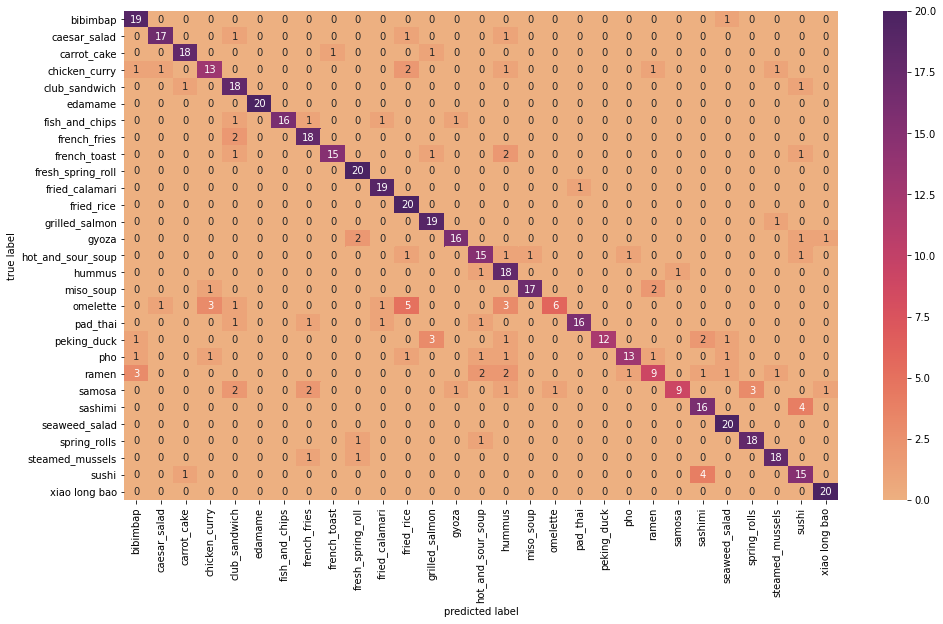

In [ ]:
df_cm = pd.DataFrame(cm, index = food_labels,
                  columns = food_labels)
plt.figure(figsize = (16,9))
sns.heatmap(df_cm, annot=True,cmap='flare')
plt.xlabel('predicted label')
plt.ylabel('true label')

#####**Accuracy**

In [ ]:
top_1_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=1)
top_1_accuracy.update_state(to_categorical(test_batches.classes),resnet50.predict(test_batches))
top_1_accuracy.result().numpy()

0.8103448

In [ ]:
top_2_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=2)
top_2_accuracy.update_state(to_categorical(test_batches.classes),resnet50.predict(test_batches))
top_2_accuracy.result().numpy()

0.90172416

In [ ]:
top_3_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=3)
top_3_accuracy.update_state(to_categorical(test_batches.classes),resnet50.predict(test_batches))
top_3_accuracy.result().numpy()

0.9413793

In [ ]:
top_5_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=5)
top_5_accuracy.update_state(to_categorical(test_batches.classes),resnet50.predict(test_batches))
top_5_accuracy.result().numpy()

0.96896553

### Inception-Resnet V2

#### Description

This model uses transfer learning to finetune the original Inception-ResNet model that was trained on the ImageNet dataset. The model combines the concepts from Inception V3 and ResNet. The preprocessing technique that was used for the model is Inception V3 Preprocessing. The model has 164 layers and ~45k parameters to finetune.


In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_resnet_v2.preprocess_input
).flow_from_directory(directory=train_path,target_size=(299,299),classes=food_labels,batch_size=100)

validation_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_resnet_v2.preprocess_input
).flow_from_directory(directory=validation_path,target_size=(299,299),classes=food_labels,batch_size=100)

test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_resnet_v2.preprocess_input
).flow_from_directory(directory=test_path,target_size=(299,299),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 76345 images belonging to 29 classes.
Found 8699 images belonging to 29 classes.
Found 580 images belonging to 29 classes.


In [ ]:
def create_inceptionresnet():
  inceptionresnet_original = InceptionResNetV2(weights='imagenet',include_top=False)
  x = inceptionresnet_original.output
  x = GlobalAveragePooling2D()(x)
  prediction = Dense(29, activation='softmax')(x)
  inceptionresnet = Model(inputs=inceptionresnet_original.input, outputs=prediction)
  for layer in inceptionresnet_original.layers:
    layer.trainable = False
  inceptionresnet.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])
  return inceptionresnet

In [ ]:
inceptionresnet = create_inceptionresnet()


219062272/219055592 [==============================] - 4s 0us/step


#### Model Diagram

In [ ]:
plot_model(inceptionresnet,show_shapes=True)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.517941 to fit
tcmalloc: large alloc 1272242176 bytes == 0x55b92444a000 @  0x7efc04d50001 0x7efc00fe71fa 0x7efc00fe72ad 0x7efc021726df 0x7efc02669261 0x7efc04ae6468 0x7efc04ae8d53 0x55b920f3a092 0x7efc0449bbf7 0x55b920f3a12a



#### Model Summary

In [ ]:
inceptionresnet.summary()

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_384 (Conv2D)             (None, None, None, 3 864         input_9[0][0]                    
__________________________________________________________________________________________________
batch_normalization_380 (BatchN (None, None, None, 3 96          conv2d_384[0][0]                 
__________________________________________________________________________________________________
activation_384 (Activation)     (None, None, None, 3 0           batch_normalization_380[0][0]    
____________________________________________________________________________________________

In [ ]:
filepath = '/content/drive/MyDrive/GA/Capstone/model_checkpoints/inceptionresnet-{epoch:02d}-{val_accuracy:.2f}.hdf5'
checkpoint = ModelCheckpoint(filepath,monitor='val_accuracy',save_best_only=True,mode='max')


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss',patience=3)

In [ ]:
callbacks_list =[early_stopping,checkpoint]

In [ ]:
inceptionresnet_history = inceptionresnet.fit(x=train_batches,epochs=100,steps_per_epoch=764,callbacks=callbacks_list,validation_data=validation_batches,validation_steps=87)

Epoch 1/100
764/764 [==============================] - 607s 762ms/step - loss: 1.5192 - accuracy: 0.5983 - val_loss: 0.7988 - val_accuracy: 0.7756
Epoch 2/100
764/764 [==============================] - 518s 678ms/step - loss: 0.7707 - accuracy: 0.7828 - val_loss: 0.7063 - val_accuracy: 0.8015
Epoch 3/100
764/764 [==============================] - 514s 673ms/step - loss: 0.6832 - accuracy: 0.8041 - val_loss: 0.6585 - val_accuracy: 0.8107
Epoch 4/100
764/764 [==============================] - 519s 679ms/step - loss: 0.6344 - accuracy: 0.8173 - val_loss: 0.6228 - val_accuracy: 0.8210
Epoch 5/100
764/764 [==============================] - 518s 677ms/step - loss: 0.5879 - accuracy: 0.8302 - val_loss: 0.6077 - val_accuracy: 0.8246
Epoch 6/100
764/764 [==============================] - 518s 678ms/step - loss: 0.5569 - accuracy: 0.8389 - val_loss: 0.5968 - val_accuracy: 0.8238
Epoch 7/100
764/764 [==============================] - 518s 677ms/step - loss: 0.5319 - accuracy: 0.8456 - val_loss: 0

In [ ]:
pd.DataFrame(inceptionresnet_history.history).to_csv('/content/drive/MyDrive/GA/Capstone/model_history/inceptionresnet_hist.csv')

#### Evaluation

The model that was selected was one at epoch 17. This was chosen due to the fact that the difference in the validation accuracy was not very different from the the epochs before earlystopping callback stopped the training. At the 17th epoch the model achieved 0.87 accuracy on the training set and 0.85 on the validation set.



##### **Epoch Accuracy and Loss**

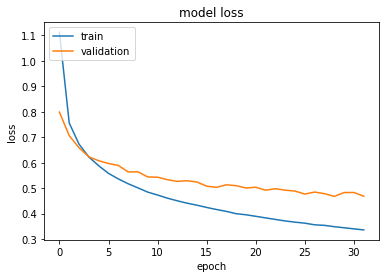

In [ ]:
plt.plot(inceptionresnet_history.history['loss'])
plt.plot(inceptionresnet_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

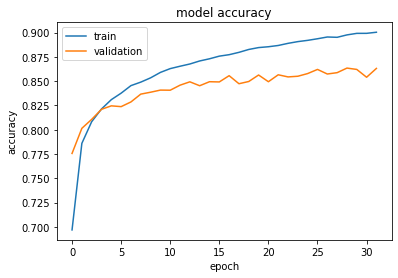

In [ ]:
plt.plot(inceptionresnet_history.history['accuracy'])
plt.plot(inceptionresnet_history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
inceptionresnet = create_inceptionresnet()

219062272/219055592 [==============================] - 1s 0us/step


In [ ]:
inceptionresnet.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/inceptionresnet-17-0.86.hdf5')

In [ ]:
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_resnet_v2.preprocess_input
).flow_from_directory(directory=test_path,target_size=(299,299),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 580 images belonging to 29 classes.


In [ ]:
test_batches.classes

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

In [ ]:
y_preds = np.array([np.argmax(p) for p in inceptionresnet.predict(test_batches)])
y_preds

array([ 0,  0,  0,  0,  3,  0,  0,  0,  0, 21,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1, 10,  1,  1,  1,  1,  1,  1, 24,  1,  1,  1,  1,
        1,  1,  1, 23, 15,  1,  2,  2, 15,  2,  2,  2, 13,  2,  2,  2, 15,
        2,  2,  8,  8,  2,  2, 12,  2,  2,  0, 16,  3,  3,  3,  3,  3,  3,
       10,  1,  3,  3, 17,  3,  3,  3,  3,  3, 17,  3,  4,  4,  4, 22,  4,
        4,  4,  4,  4,  4,  4, 23,  4, 15,  4,  8,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6, 17,
       12,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8, 17, 15,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8, 17,  8,  9, 25,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

#####**Confusion Matrix**

In [ ]:
cm = confusion_matrix(test_batches.classes,y_preds)

Text(122.09375, 0.5, 'true label')

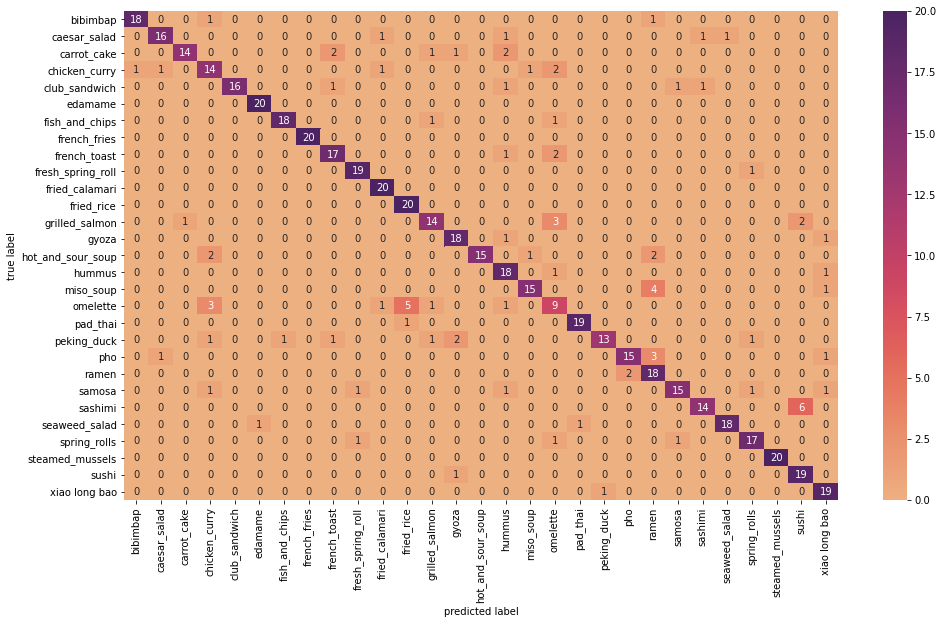

In [ ]:
df_cm = pd.DataFrame(cm, index = food_labels,
                  columns = food_labels)
plt.figure(figsize = (16,9))
sns.heatmap(df_cm, annot=True,cmap='flare')
plt.xlabel('predicted label')
plt.ylabel('true label')

#####**Accuracy**

In [ ]:
top_1_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=1)
top_1_accuracy.update_state(to_categorical(test_batches.classes),inceptionresnet.predict(test_batches))
top_1_accuracy.result().numpy()

0.8413793

In [ ]:
top_2_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=2)
top_2_accuracy.update_state(to_categorical(test_batches.classes),inceptionresnet.predict(test_batches))
top_2_accuracy.result().numpy()

0.92413795

In [ ]:
top_3_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=3)
top_3_accuracy.update_state(to_categorical(test_batches.classes),inceptionresnet.predict(test_batches))
top_3_accuracy.result().numpy()

0.94655174

In [ ]:
top_5_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=5)
top_5_accuracy.update_state(to_categorical(test_batches.classes),inceptionresnet.predict(test_batches))
top_5_accuracy.result().numpy()

0.9741379

### Inception-Resnet V2 with Dropout

#### Description

This model is similar to the previous Inception-ResNet model with the difference being the additional layer in the fully connected layer and a 0.5 Dropout. The preprocessing technique that was used for the model is Inception V3 Preprocessing. The model has 165 layers and ~1.6m parameters to finetune.

In [ ]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_resnet_v2.preprocess_input
).flow_from_directory(directory=train_path,target_size=(299,299),classes=food_labels,batch_size=100)

validation_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_resnet_v2.preprocess_input
).flow_from_directory(directory=validation_path,target_size=(299,299),classes=food_labels,batch_size=100)

test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_resnet_v2.preprocess_input
).flow_from_directory(directory=test_path,target_size=(299,299),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 76345 images belonging to 29 classes.
Found 8699 images belonging to 29 classes.
Found 580 images belonging to 29 classes.


In [ ]:
def create_inceptionresnet_dropout():
  inceptionresnet_original = InceptionResNetV2(weights='imagenet',include_top=False)
  x = inceptionresnet_original.output
  x = GlobalAveragePooling2D()(x)
  x = Dense(1024, activation='relu')(x)
  x = Dropout(0.5)(x)
  prediction = Dense(29, activation='softmax')(x)
  inceptionresnet = Model(inputs=inceptionresnet_original.input, outputs=prediction)
  for layer in inceptionresnet_original.layers:
    layer.trainable = False
  inceptionresnet.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])
  return inceptionresnet

In [ ]:
inceptionresnet = create_inceptionresnet_dropout()


#### Model Diagram

In [ ]:
plot_model(inceptionresnet,show_shapes=True)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.516138 to fit
tcmalloc: large alloc 1259266048 bytes == 0x55a0bc25e000 @  0x7f260fcaa001 0x7f260bf411fa 0x7f260bf412ad 0x7f260d0cc6df 0x7f260d5c3261 0x7f260fa40468 0x7f260fa42d53 0x55a0b94bb092 0x7f260f3f5bf7 0x55a0b94bb12a



#### Model Summary

In [ ]:
inceptionresnet.summary()

Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_587 (Conv2D)             (None, None, None, 3 864         input_10[0][0]                   
__________________________________________________________________________________________________
batch_normalization_583 (BatchN (None, None, None, 3 96          conv2d_587[0][0]                 
__________________________________________________________________________________________________
activation_587 (Activation)     (None, None, None, 3 0           batch_normalization_583[0][0]    
____________________________________________________________________________________________

In [ ]:
filepath = '/content/drive/MyDrive/GA/Capstone/model_checkpoints/inceptionresnet-dropout-{epoch:02d}-{val_accuracy:.2f}.hdf5'
checkpoint = ModelCheckpoint(filepath,monitor='val_accuracy',save_best_only=True,mode='max')


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss',patience=3)

In [ ]:
callbacks_list =[early_stopping,checkpoint]

In [ ]:
inceptionresnet_history = inceptionresnet.fit(x=train_batches,epochs=100,steps_per_epoch=764,callbacks=callbacks_list,validation_data=validation_batches,validation_steps=87)

Epoch 1/100
764/764 [==============================] - 545s 701ms/step - loss: 1.4293 - accuracy: 0.5873 - val_loss: 0.7678 - val_accuracy: 0.7733
Epoch 2/100
764/764 [==============================] - 520s 680ms/step - loss: 0.8672 - accuracy: 0.7423 - val_loss: 0.7061 - val_accuracy: 0.7870
Epoch 3/100
764/764 [==============================] - 518s 677ms/step - loss: 0.7945 - accuracy: 0.7644 - val_loss: 0.6569 - val_accuracy: 0.8056
Epoch 4/100
764/764 [==============================] - 513s 671ms/step - loss: 0.7339 - accuracy: 0.7772 - val_loss: 0.6027 - val_accuracy: 0.8157
Epoch 5/100
764/764 [==============================] - 512s 670ms/step - loss: 0.6916 - accuracy: 0.7906 - val_loss: 0.5793 - val_accuracy: 0.8262
Epoch 6/100
764/764 [==============================] - 515s 673ms/step - loss: 0.6811 - accuracy: 0.7937 - val_loss: 0.5900 - val_accuracy: 0.8203
Epoch 7/100
764/764 [==============================] - 511s 669ms/step - loss: 0.6359 - accuracy: 0.8091 - val_loss: 0

In [ ]:
pd.DataFrame(inceptionresnet_history.history).to_csv('/content/drive/MyDrive/GA/Capstone/model_history/inceptionresnet_dropout_hist.csv')

#### Evaluation

The model that was selected was one at epoch 18. This was chosen due to the fact that the difference in the validation accuracy was not very different from the the epochs before earlystopping callback stopped the training. At the 18th epoch the model achieved 0.85 accuracy on the training set and 0.86 on the validation set.

In [ ]:
inceptionresnet = create_inceptionresnet_dropout()

219062272/219055592 [==============================] - 2s 0us/step


In [ ]:
inceptionresnet.load_weights('/content/drive/MyDrive/GA/Capstone/model_checkpoints/inceptionresnet-dropout-18-0.87.hdf5')

In [ ]:
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_resnet_v2.preprocess_input
).flow_from_directory(directory=test_path,target_size=(299,299),classes=food_labels,batch_size=100,seed=42,shuffle=False)

Found 580 images belonging to 29 classes.


In [ ]:
test_batches.classes

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

In [ ]:
y_preds = np.array([np.argmax(p) for p in inceptionresnet.predict(test_batches)])
y_preds

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1, 23,  1,  1,  2,  2, 15,  2,  2,  2,  2,  2,  2,  2, 15,
        2,  2,  8,  2,  2,  2, 12,  2,  2,  0, 16,  3,  3,  3,  3,  3,  3,
       10,  1,  3,  3,  3,  3,  3,  3,  3,  3, 17,  3,  4,  4,  4, 22,  4,
        4,  4,  4,  4,  4,  4, 23,  4, 15,  4,  7,  4,  4,  4,  4,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  7,  6,  6,  6,  6,  6,  6,
       12,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8, 17, 22,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8, 17,  8,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10, 10, 23, 10, 10, 10, 10, 10, 10, 10, 11,
       11, 11, 11, 11, 11

##### **Confusion Matrix**

In [ ]:
cm = confusion_matrix(test_batches.classes,y_preds)

Text(122.09375, 0.5, 'true label')

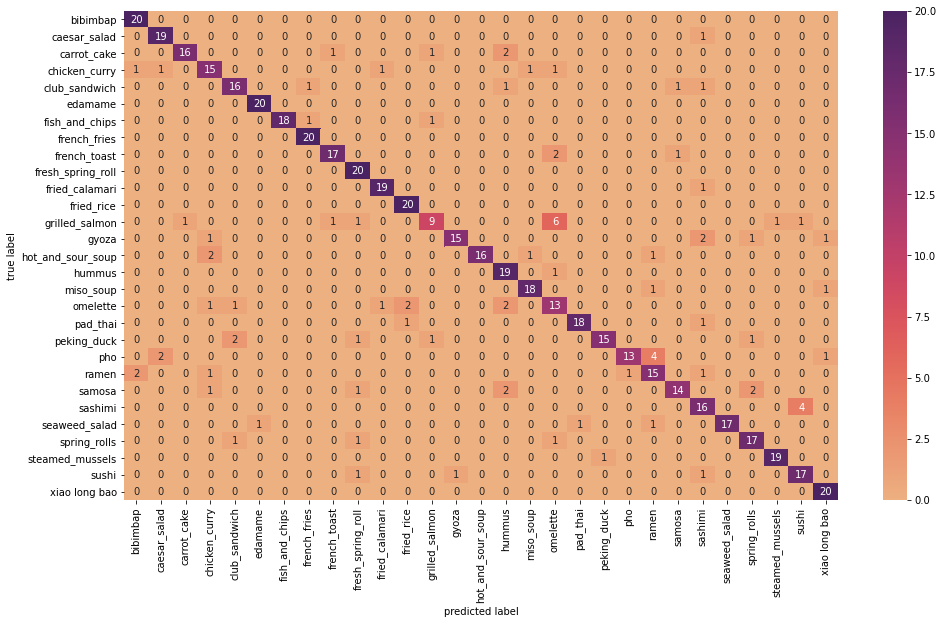

In [ ]:
df_cm = pd.DataFrame(cm, index = food_labels,
                  columns = food_labels)
plt.figure(figsize = (16,9))
sns.heatmap(df_cm, annot=True,cmap='flare')
plt.xlabel('predicted label')
plt.ylabel('true label')

##### **Accuracy**

In [ ]:
top_1_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=1)
top_1_accuracy.update_state(to_categorical(test_batches.classes),inceptionresnet.predict(test_batches))
top_1_accuracy.result().numpy()

0.8465517

In [ ]:
top_2_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=2)
top_2_accuracy.update_state(to_categorical(test_batches.classes),inceptionresnet.predict(test_batches))
top_2_accuracy.result().numpy()

0.9275862

In [ ]:
top_3_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=3)
top_3_accuracy.update_state(to_categorical(test_batches.classes),inceptionresnet.predict(test_batches))
top_3_accuracy.result().numpy()

0.95

In [ ]:
top_5_accuracy = tf.keras.metrics.TopKCategoricalAccuracy(k=5)
top_5_accuracy.update_state(to_categorical(test_batches.classes),inceptionresnet.predict(test_batches))
top_5_accuracy.result().numpy()

0.9741379

### Models Evaluation

All of the models performed better than the baseline model which has an accuracy of 3.4%.

In [ ]:
labels = ['Custom', 'VGG16', 'VGG16 Dropout', 'InceptionV3 Dropout', 'InceptionV3 GAP','ResNet50','Inception-ResNetV2','Inception-ResNetV2 Dropout']
training_acc = [0.78,0.83,0.81,0.86,0.83,0.88,0.87,0.85]
valid_acc = [0.72,0.77,0.84,0.85,0.81,0.84,0.85,0.86]
test_acc = [0.63,0.67,0.77,0.84,0.84,0.81,0.84,0.84]

model_acc_sorted = sorted(list(zip(labels,training_acc,valid_acc,test_acc)),key=lambda x: x[3],reverse=True)
print(model_acc_sorted)

labels = [value[0] for value in model_acc_sorted]
training_acc = [value[1] for value in model_acc_sorted]
valid_acc = [value[2] for value in model_acc_sorted]
test_acc = [value[3] for value in model_acc_sorted]

[('InceptionV3 Dropout', 0.86, 0.85, 0.84), ('InceptionV3 GAP', 0.83, 0.81, 0.84), ('Inception-ResNetV2', 0.87, 0.85, 0.84), ('Inception-ResNetV2 Dropout', 0.85, 0.86, 0.84), ('ResNet50', 0.88, 0.84, 0.81), ('VGG16 Dropout', 0.81, 0.84, 0.77), ('VGG16', 0.83, 0.77, 0.67), ('Custom', 0.78, 0.72, 0.63)]


#### Accuracy Comparison

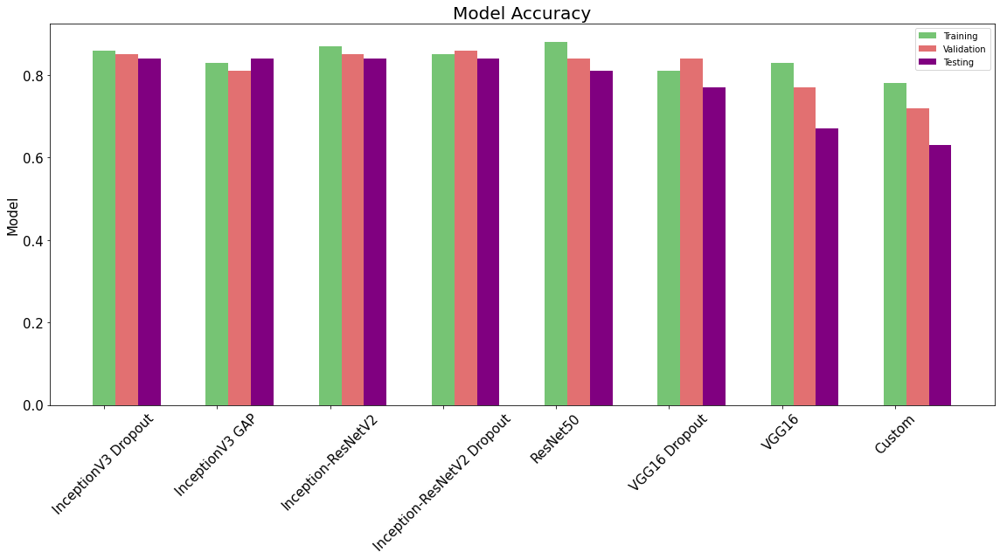

In [ ]:
x = np.arange(len(labels))  # the label locations
width = 0.20  # the width of the bars


fig, ax = plt.subplots(figsize=(16,9))
rects1 = ax.bar(x, training_acc, width, label='Training', color='#76c474')
rects2 = ax.bar(x+width, valid_acc, width, label='Validation', color='#e27071')
rects3 = ax.bar(x + 2*width, test_acc, width, label='Testing', color='purple')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Model',size=15)

ax.set_title('Model Accuracy',size=20)
ax.set_xticks(x)
ax.set_xticklabels(labels,rotation=45)
ax.legend()

plt.tick_params(axis='both', which='major', labelsize=15)



fig.tight_layout()

The graph above shows the training, validation and testing accuracy for the 8 models trained. They are ranked on the performance on the unseen testing set. In this case, 'Inception V3 Dropout', 'InceptionV3 GAP', 'Inception-ResNetV2' and 'Inception-ResNetV2 Dropout' all scored 0.84 accuracy on the testing set. Thus, these four models generally have low bias. However, as the graph shows, when we take into account the training and validation accuracies, we can see that 'Inception V3 Dropout' generalises the best without suffering from the overfitting problem (high variance). Therefore, this model will be used as the classification engine for our web application.

In [ ]:
labels = ['InceptionV3 Dropout', 'InceptionV3 GAP','Inception-ResNetV2','Inception-ResNetV2 Dropout']
top1 = [0.84,0.84,0.84,0.84]
top3 = [0.95,0.95,0.94,0.95]
top5 = [0.97,0.98,0.97,0.97]

model_acc_sorted = sorted(list(zip(labels,training_acc,valid_acc,test_acc)),key=lambda x: x[3],reverse=True)
print(model_acc_sorted)

labels = [value[0] for value in model_acc_sorted]
top1 = [value[1] for value in model_acc_sorted]
top3 = [value[2] for value in model_acc_sorted]
top5 = [value[3] for value in model_acc_sorted]

[('InceptionV3 Dropout', 0.86, 0.85, 0.84), ('InceptionV3 GAP', 0.83, 0.81, 0.84), ('Inception-ResNetV2', 0.87, 0.85, 0.84), ('Inception-ResNetV2 Dropout', 0.85, 0.86, 0.84)]


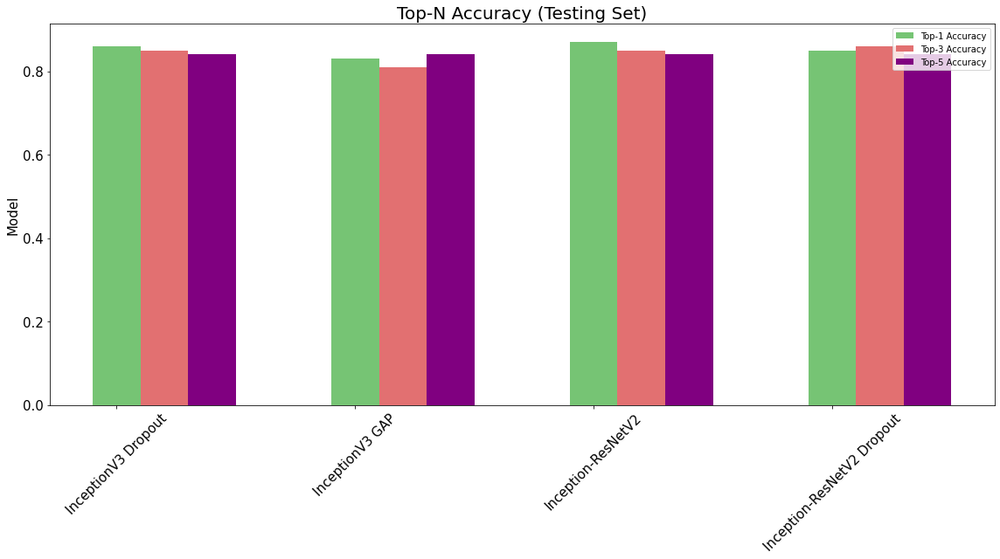

In [ ]:
x = np.arange(len(labels))  # the label locations
width = 0.20  # the width of the bars


fig, ax = plt.subplots(figsize=(16,9))
rects1 = ax.bar(x, top1, width, label='Top-1 Accuracy', color='#76c474')
rects2 = ax.bar(x + width, top3, width, label='Top-3 Accuracy', color='#e27071')
rects3 = ax.bar(x + 2*width, top5, width, label='Top-5 Accuracy', color='purple')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Model',size=15)

ax.set_title('Top-N Accuracy (Testing Set)',size=20)
ax.set_xticks(x)
ax.set_xticklabels(labels,rotation=45)
ax.legend()
plt.tick_params(axis='both', which='major', labelsize=15)
fig.tight_layout()

Top N accuracy measures how often the predicted class falls in the top N values of your softmax distribution. This metric can be useful to capture the accuracy in cases where there are more than one food types in an image. For example, 'Fish and Chips' and 'French Fries' both have french fries in them. This will activate the neurons responsible for detecting both of the categories leading to the eventual classification being either of the category. Technically, the classification is not *wrong* per se because both food are present. This problem could be remedied by adding class weights that help prioritise certain classes over others. Future iterations of the model could be improved using this strategy.

#### Confusion Matrix for Inception V3 Dropout

Text(122.09375, 0.5, 'true label')

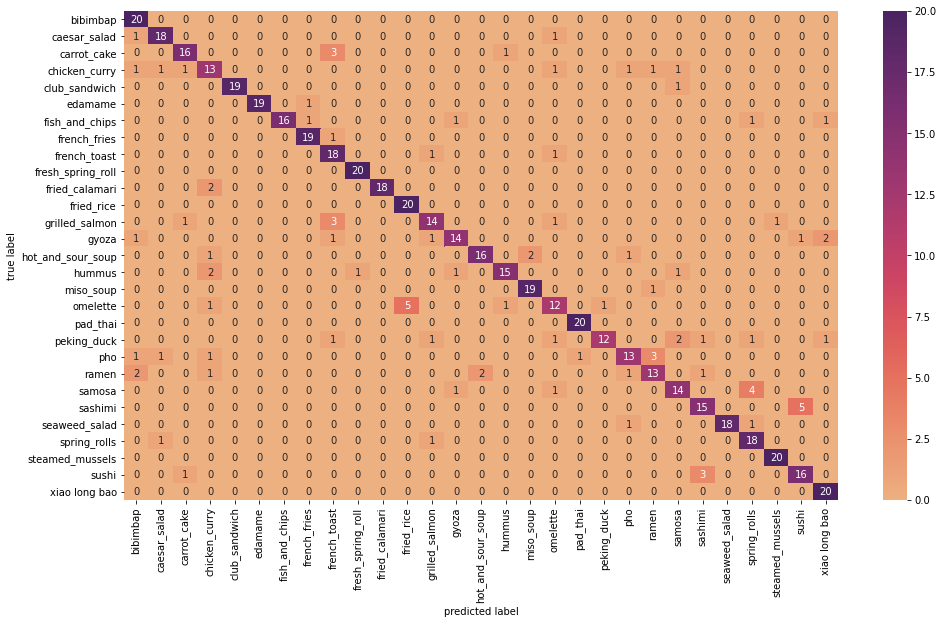

In [ ]:
df_cm = pd.DataFrame(cm, index = food_labels,
                  columns = food_labels)
plt.figure(figsize = (16,9))
sns.heatmap(df_cm, annot=True,cmap='flare')
plt.xlabel('predicted label')
plt.ylabel('true label')

As shown in the confusion matrix, overall, the accuracies for all the categories are all 50% or more with regards to the unseen testing set. Some of the categories have 100% on the testing set. The list includes 'bibimbap', 'fresh spring rolls', 'fried rice', 'pad thai', 'steamed mussels' and 'xiao long bao'. Some of the classes that did not perform so well include 'omelette', 'peking ducks', 'pho' and 'ramen'.

#### Misclassification Analysis

In [ ]:
best_model = load_model('/content/drive/MyDrive/GA/Capstone/model_checkpoints/best_model.hdf5')

In [ ]:
food_labels

['bibimbap',
 'caesar_salad',
 'carrot_cake',
 'chicken_curry',
 'club_sandwich',
 'edamame',
 'fish_and_chips',
 'french_fries',
 'french_toast',
 'fresh_spring_roll',
 'fried_calamari',
 'fried_rice',
 'grilled_salmon',
 'gyoza',
 'hot_and_sour_soup',
 'hummus',
 'miso_soup',
 'omelette',
 'pad_thai',
 'peking_duck',
 'pho',
 'ramen',
 'samosa',
 'sashimi',
 'seaweed_salad',
 'spring_rolls',
 'steamed_mussels',
 'sushi',
 'xiao long bao']

In [ ]:
num_misclassified = []

for i in range(29):
  test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input).flow_from_directory(directory=test_path,target_size=(299,299),classes=[food_labels[i]],batch_size=100,seed=42,shuffle=False)
  y_preds = np.array([np.argmax(p) for p in best_model.predict(test_batches)])
  occurrences = np.count_nonzero(y_preds != i)
  num_misclassified.append(occurrences)

Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.
Found 20 images belonging to 1 classes.


In [ ]:
misclassfied_pct = np.divide(num_misclassified,20)
misclassfied_pct

array([0.  , 0.1 , 0.2 , 0.35, 0.05, 0.05, 0.2 , 0.05, 0.1 , 0.  , 0.1 ,
       0.  , 0.3 , 0.3 , 0.2 , 0.25, 0.05, 0.4 , 0.  , 0.4 , 0.35, 0.35,
       0.3 , 0.25, 0.1 , 0.1 , 0.  , 0.2 , 0.  ])

In [ ]:
misclassification = sorted(list(zip(food_labels,num_misclassified,misclassfied_pct)),key=lambda x: x[2],reverse=True)
misclassification

[('omelette', 8, 0.4),
 ('peking_duck', 8, 0.4),
 ('chicken_curry', 7, 0.35),
 ('pho', 7, 0.35),
 ('ramen', 7, 0.35),
 ('grilled_salmon', 6, 0.3),
 ('gyoza', 6, 0.3),
 ('samosa', 6, 0.3),
 ('hummus', 5, 0.25),
 ('sashimi', 5, 0.25),
 ('carrot_cake', 4, 0.2),
 ('fish_and_chips', 4, 0.2),
 ('hot_and_sour_soup', 4, 0.2),
 ('sushi', 4, 0.2),
 ('caesar_salad', 2, 0.1),
 ('french_toast', 2, 0.1),
 ('fried_calamari', 2, 0.1),
 ('seaweed_salad', 2, 0.1),
 ('spring_rolls', 2, 0.1),
 ('club_sandwich', 1, 0.05),
 ('edamame', 1, 0.05),
 ('french_fries', 1, 0.05),
 ('miso_soup', 1, 0.05),
 ('bibimbap', 0, 0.0),
 ('fresh_spring_roll', 0, 0.0),
 ('fried_rice', 0, 0.0),
 ('pad_thai', 0, 0.0),
 ('steamed_mussels', 0, 0.0),
 ('xiao long bao', 0, 0.0)]

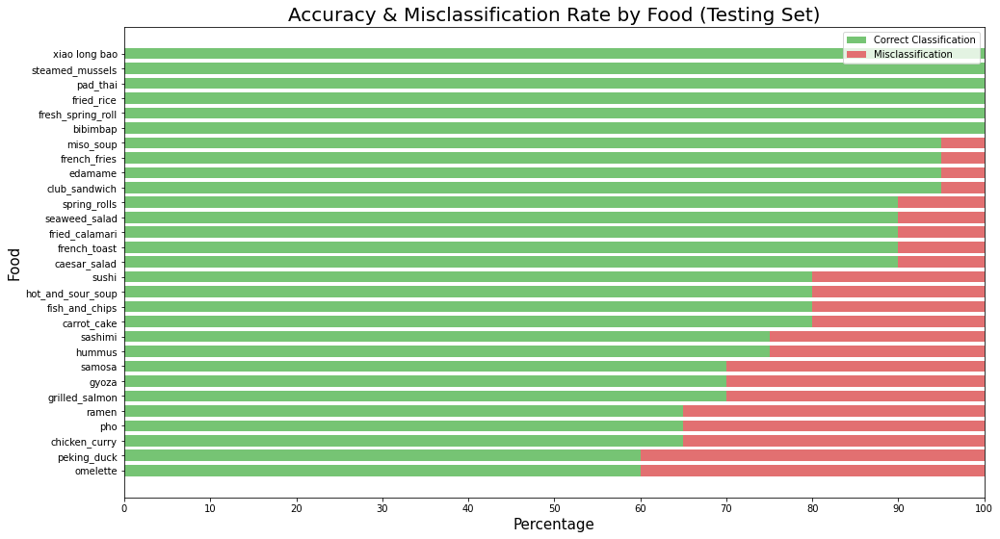

In [ ]:
labels = [x[0] for x in misclassification]
misclassification_rate = [x[2]*100 for x in misclassification]
accuracy = [(1-x[2])*100 for x in misclassification]

width = 0.75       # the width of the bars: can also be len(x) sequence

fig, ax = plt.subplots(figsize=(16,9))

ax.barh(labels, accuracy, width, label='Correct Classification', color='#76c474')
ax.barh(labels, misclassification_rate, width, left=accuracy,label='Misclassification', color='#e27071')

ax.set_xticks(np.arange(0,101,10))
ax.set_yticklabels(labels)
ax.set_xlabel('Percentage',size=15)
ax.set_ylabel('Food',size=15)
ax.set_title('Accuracy & Misclassification Rate by Food (Testing Set)',size=20)
ax.legend()


The graph shows the correct and incorrect classification rate for each food class. It can be noted that omelette, peking duck and chicken curry have have around 40% misclassification rate on the testing set. This is due, in part, to the fact that these categories have a wide variations of food images. For example, the category 'chicken_curry' includes all types of chicken curry whether it's Indian, Japanese and thus there is a high variance in these images. In future iterations, categories like these could be split into subcategories.

##### **Examples of Misclassified Images (Testing Set)**

In [ ]:
def plotImages_misc(images_arr,label,actual_labels):
    num_images = len(label)
    if num_images % 5 == 0:
      num_rows = int(num_images/5)
    else:
      num_rows = int(num_images//5)+1  
    fig, axes = plt.subplots(num_rows,5,figsize=(16,45))
    axes = axes.flatten()
    for imag,lb,alb, ax in zip(images_arr,label,actual_labels,axes):
        food_name = lb
        ax.imshow(imag.astype('uint8'))
        ax.set_title("True: " +alb+"\nPred:" + lb)
        ax.axis('off')
    remainder = (5*num_rows)-num_images
    for i in range(remainder):
      i = i+1
      axes[-i].axis('off')
    plt.tight_layout()
    #plt.show()

In [ ]:
im_arrays = np.array([])
plabel = []
alabel = []

for idx,fclass in enumerate(food_labels):
  test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.inception_v3.preprocess_input).flow_from_directory(directory=test_path,target_size=(299,299),classes=[food_labels[idx]],batch_size=100,seed=42,shuffle=False)
  test_batches_original = ImageDataGenerator().flow_from_directory(directory=test_path,target_size=(299,299),classes=[food_labels[idx]],batch_size=100,seed=42,shuffle=False)
  y_preds = np.array([np.argmax(p) for p in best_model.predict(test_batches)])
  result = np.where(y_preds != idx )[0]
  result_class = [food_label_dict[y_preds[x]] for x in result]

  img,label = next(test_batches_original)
  for r,rclass in zip(result,result_class):
    im1 = img[r]
    im_arrays = np.append(im_arrays,im1)
    plabel.append(rclass)
    alabel.append(food_labels[idx])

im_arrays = im_arrays.reshape(-1,299,299,3)

In [ ]:
im_arrays.shape

(95, 299, 299, 3)

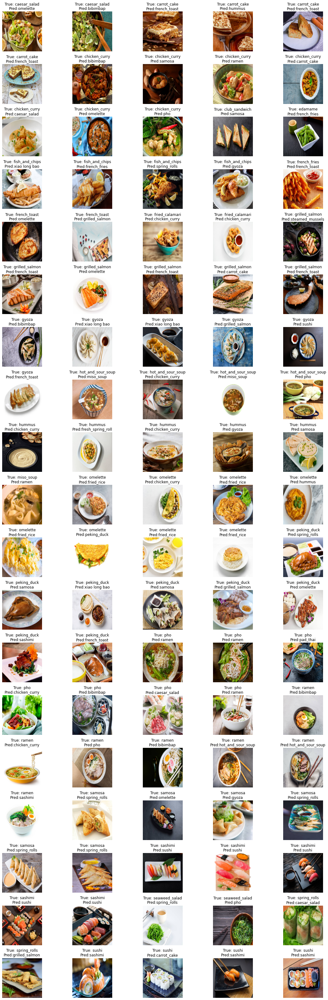

In [ ]:
plotImages_misc(im_arrays,plabel,alabel)

The images above show all of the misclassified images in the testing set. Interestingly, the model seems to be weaker in distinguishing between similar food classes as 'pho' and 'ramen' where they can sometimes mistake one for another. 'Omelette' seems to get misclassified a lot for 'fried_rice'. Upon further investigation, it was found that the images in the training set for 'Omelette' mostly contain images of omelette on its own without rice. This is slightly different from the testing set where some of the images of Omelette contain rice. 'Peking Duck' is another class that gets misclassified 0.4 of th time. This could be due to the fact that there is a wide variety of 'Peking duck' food presentation as shown in the testing examples above. To improve this, we will need more images of the food class with different style of food presentation in order to improve accuracy. 

### Model Demo/Local Deployment

Having identified that Inception V3 Dropout was the best model trained out of the other seven models. This model was saved and a web application was created using Streamlit in order to demonstrate the classification capability. The user uploads an image of a food belonging to one of the twenty nine food categories.

*The Python files for the Model Demo can be found in the github repository*

<img src="https://github.com/bosssarawongsuth/cnn_food_classification/blob/main/images/demo1.PNG?raw=true" style="float: left; margin: 20px; height: 55px">

The web app uses the Inception V3 Dropout model to classify the image and gives the prediction probability for the class.

<img src="https://github.com/bosssarawongsuth/cnn_food_classification/blob/main/images/demo2.PNG?raw=true" style="float: left; margin: 20px; height: 55px">

The web app also gives the classification breakdown for what the other food class that it thinks the image could belong to as well as their corresponding probability. It also gives the nutrition facts such as Calories, carb, fat and protein per 100 grams of the identified food. The nutrition facts information was taken from [MyFoodData](https://www.myfooddata.com/) and stored in a csv file. Future improvements could incorporate API calls to food information providers to include more food classes.

<img src="https://github.com/bosssarawongsuth/cnn_food_classification/blob/main/images/demo3.PNG?raw=true" style="float: left; margin: 20px; height: 55px">

### Conclusion

In conclusion, the best model created (Inception V3 Dropout) was able to satisfactorily classify the 29 different classes of food. Eventhough some food classes were shown to be more challenging than others, the model was still able to perform far better than the baseline accuracy of 3.4%. The model could be deployed on AWS service such as SageMaker to make the model accessible by mobile applications.

However, the model does not come without any limitations. The first limitation is the handling of images with multiple food classes in them. This arises because some food classes often come with another. For example, Fish and Chips vs French Fries. A possible solution to this problem might be to assign class weight when training to priotise certain classes over others. The second limitation is the problem with large intra-class diversity. This is where food images belonging to the same class might look drastically different due to different presentations, etc. This could be overcome by acquiring more training data and/or split classes into subclasses. The third limitation is having large inter-class similarity. This issue arises when there are multiple food classes that look similar. For example, Sushi vs Sashimi. A possible solution for this would be the acquire more training data and/or group very similar classes together into one umbrella class.

The model currently only predicts 29 food classes. This is something that future iterations could improve by introducing more classes of food. This would require a substancial amount of labelled food images so the model could be refitted.